In [1]:
## Create a Custom Dataset for SVHN database
import scipy.io as sio
from google.colab import drive
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
# Mount Google Drive
drive.mount('/content/drive')
data_path = '/content/drive/My Drive/Final_DL/Data'
results_path = '/content/drive/My Drive/Final_DL/Results'

# All the data will be loaded from the provided file in Data/mnist.t
import torch 
import torch.nn as nn
import torchvision
import torchvision.transforms as tf
import matplotlib.pyplot as plt
from PIL import Image
import scipy.io as sio
from torchvision.datasets import ImageFolder
from torchvision.transforms import ToTensor


simpson = ImageFolder(root=data_path, transform=ToTensor())
train_loader = torch.utils.data.DataLoader(dataset=simpson,
                                           batch_size=64, 
                                           shuffle=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


torch.Size([64, 3, 64, 64])


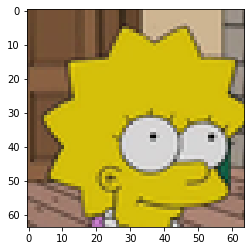

In [2]:
images = next(iter(train_loader))
images_aux = images[0]
print(images_aux.shape)
image = images_aux[10,:,:,:]
plt.imshow(image.permute(1,2,0).squeeze().numpy())
plt.show()  

In [3]:
import torch
import torch.nn as nn

# Convolution + BatchNormnalization + ReLU block for the encoder
class ConvBNReLU(nn.Module):
  def __init__(self,in_channels, out_channels, pooling=False):
    super(ConvBNReLU, self).__init__()
    self.conv = nn.Conv2d(in_channels,out_channels,kernel_size=3,
                          padding = 1)
    self.bn = nn.BatchNorm2d(out_channels)
    self.relu = nn.ReLU(inplace=True)

    self.pool = None
    if(pooling):
      self.pool = nn.AvgPool2d(2,2)

  def forward(self,x):
    if(self.pool):
      out = self.pool(x)
    else:
      out = x
    out = self.relu(self.bn(self.conv(out)))   
    return out

#  BatchNormnalization + ReLU block + Convolution for the decoder
class BNReLUConv(nn.Module):
  def __init__(self,in_channels, out_channels, pooling=False):
    super(BNReLUConv, self).__init__()
    self.bn = nn.BatchNorm2d(in_channels)
    self.relu = nn.ReLU(inplace=True)
    self.conv = nn.Conv2d(in_channels,out_channels,kernel_size=3,
                          padding = 1)

    self.pool = None
    if(pooling):
      self.pool = nn.UpsamplingNearest2d(scale_factor=2)

  def forward(self,x):
    out = self.relu(self.bn(x))
    if(self.pool):
      out = self.pool(out)
    out = self.conv(out)
    return out

# Encoder definition with 3 COnv-BN-ReLU blocks and fully-connected layer
class Encoder(nn.Module):
  def __init__(self,out_features,base_channels=16):
    super(Encoder, self).__init__()
    self.layer1 = ConvBNReLU(3,base_channels,pooling=False)
    self.layer2 = ConvBNReLU(base_channels,base_channels*2,pooling=True)
    self.layer3 = ConvBNReLU(base_channels*2,base_channels*4,pooling=False)
    self.layer4 = ConvBNReLU(base_channels*4,base_channels*8,pooling=True)
    self.layer5 = ConvBNReLU(base_channels*8,base_channels*16,pooling=False)
    self.fc = nn.Linear(16*16*base_channels*16,out_features)
  
  def forward(self,x):
    out = self.layer1(x)
    out = self.layer2(out)
    out = self.layer3(out)
    out = self.layer4(out)
    out = self.layer5(out)
    return self.fc(out.view(x.shape[0],-1))
    
# Decoder definition with a fully-connected layer and 3 BN-ReLU-COnv blocks and 
class Decoder(nn.Module):
  def __init__(self,out_features,base_channels=16):
    super(Decoder, self).__init__()
    self.base_channels = base_channels
    self.fc = nn.Linear(out_features,16*16*base_channels*16)
    self.layer5 = BNReLUConv(base_channels*16,base_channels*8,pooling=False)
    self.layer4 = BNReLUConv(base_channels*8,base_channels*4,pooling=True)
    self.layer3 = BNReLUConv(base_channels*4,base_channels*2,pooling=False)
    self.layer2 = BNReLUConv(base_channels*2,base_channels,pooling=True)
    self.layer1 = BNReLUConv(base_channels,3,pooling=False)
  
  def forward(self,x):
    out = self.fc(x)
    out = out.view(x.shape[0],self.base_channels*16,16,16)
    out = self.layer5(out)
    out = self.layer4(out)
    out = self.layer3(out)
    out = self.layer2(out)
    out = self.layer1(out)
    return torch.sigmoid(out)

## Sol. 2

In [4]:
# Discriminator similar to VAE encoder
class Discriminator(nn.Module):
  def __init__(self, base_channels=16):
    super(Discriminator, self).__init__()
    # last fully connected layer acts as a a binary classifier
    self.classifier = Encoder(1,base_channels)

  # Forward pass obtaining the discriminator probability
  def forward(self,x):
    out = self.classifier(x)
    # use sigmoid to get the real/fake image probability
    return torch.sigmoid(out)

# Generator is defined as VAE decoder
class Generator(nn.Module):
  def __init__(self,in_features,base_channels=16):
    super(Generator, self).__init__()
    self.base_channels = base_channels
    self.in_features = in_features
    self.decoder = Decoder(in_features,base_channels)

  # Generate an image from vector z
  def forward(self,z):
    return torch.sigmoid(self.decoder(z))

  # Sample a set of images from random vectors z
  def sample(self,n_samples=64,device='cpu'):
    samples_unit_normal = torch.randn((n_samples,self.in_features)).to(device)
    return self.decoder(samples_unit_normal)

In [5]:
# GAN Train function. We have a generator and discriminator models and their respective optimizers.
def train_GAN(gen, disc,  train_loader, optimizer_gen, optim_disc,
              num_epochs=10, model_name='gan_mnist.ckpt', device='cpu'):
    gen = gen.to(device)
    gen.train() # Set the generator in train mode
    disc = disc.to(device)
    disc.train() # Set the discriminator in train mode

    total_step = len(train_loader)
    losses_list_disc = []
    losses_list_gen = []

    # Iterate over epochs
    for epoch in range(num_epochs):
        # Iterate the dataset
        disc_loss_avg = 0
        gen_loss_avg = 0
        nBatches = 0
        update_generator = True

        for i, (real_imagess) in enumerate(train_loader):
            # Get batch of samples and labels
            real_images = real_imagess[0]
            real_images = real_images.to(device)
            n_images = real_images.shape[0]

            # Forward pass
            # Generate random images with the generator
            fake_images = gen.sample(n_images,device=device)
            
            # Use the discriminator to obtain the probabilties for real and generate imee
            prob_real = disc(real_images)
            prob_fake = disc(fake_images)
            
            # Generator loss
            gen_loss = -torch.log(prob_fake).mean()
            # Discriminator loss
            disc_loss = -0.5*(torch.log(prob_real) + torch.log(1-prob_fake)).mean()

            
            # We are going to update the discriminator and generator parameters alternatively at each iteration

            if(update_generator):
              # Optimize generator
              # Backward and optimize
              optimizer_gen.zero_grad()
              gen_loss.backward() # Necessary to not erase intermediate variables needed for computing disc_loss gradient
              optimizer_gen.step()
              update_generator = False
            else:           
              # Optimize discriminator
              # Backward and optimize
              optimizer_disc.zero_grad()
              disc_loss.backward()
              optimizer_disc.step()
              update_generator = True
                

            disc_loss_avg += disc_loss.cpu().item()
            gen_loss_avg += gen_loss.cpu().item()

            nBatches+=1
            if (i+1) % 150 == 0:
                print ('Epoch [{}/{}], Step [{}/{}], Gen. Loss: {:.4f}, Disc Loss: {:.4f}' 
                       .format(epoch+1, num_epochs, i+1, total_step, gen_loss_avg / nBatches, disc_loss_avg / nBatches))
        print ('Epoch [{}/{}], Step [{}/{}], Gen. Loss: {:.4f}, Disc Loss: {:.4f}' 
                       .format(epoch+1, num_epochs, i+1, total_step, gen_loss_avg / nBatches, disc_loss_avg / nBatches))
        # Save model
        losses_list_disc.append(disc_loss_avg / nBatches)
        losses_list_gen.append(gen_loss_avg / nBatches)
        torch.save(gan_gen.state_dict(), results_path+ '/' + model_name)

        if ((epoch+1) % 20 == 0 or (epoch+1) == 1):

          n_samples = 64
          n_iterpolations =50

          x_gen = gan_gen.sample(n_samples,device=device)
          image_grid = make_grid(x_gen.cpu(),nrow=8,padding=1)
          plt.figure(figsize=(8,8))
          plt.title('Generated Images')
          plt.imshow(image_grid.permute(1,2,0).detach().numpy())
          plt.show()
          
    return losses_list_disc, losses_list_gen

Epoch [1/2000], Step [32/32], Gen. Loss: 0.8400, Disc Loss: 0.6455


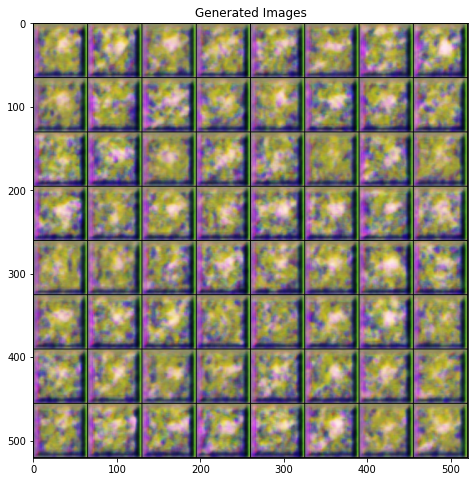

Epoch [2/2000], Step [32/32], Gen. Loss: 0.8011, Disc Loss: 0.8807
Epoch [3/2000], Step [32/32], Gen. Loss: 0.9484, Disc Loss: 0.7626
Epoch [4/2000], Step [32/32], Gen. Loss: 1.2959, Disc Loss: 0.5312
Epoch [5/2000], Step [32/32], Gen. Loss: 1.1310, Disc Loss: 0.6755
Epoch [6/2000], Step [32/32], Gen. Loss: 1.2210, Disc Loss: 0.6394
Epoch [7/2000], Step [32/32], Gen. Loss: 1.4473, Disc Loss: 0.4767
Epoch [8/2000], Step [32/32], Gen. Loss: 1.4830, Disc Loss: 0.8497
Epoch [9/2000], Step [32/32], Gen. Loss: 1.2321, Disc Loss: 0.6399
Epoch [10/2000], Step [32/32], Gen. Loss: 2.5561, Disc Loss: 0.2988
Epoch [11/2000], Step [32/32], Gen. Loss: 2.1715, Disc Loss: 0.2237
Epoch [12/2000], Step [32/32], Gen. Loss: 1.7777, Disc Loss: 0.4820
Epoch [13/2000], Step [32/32], Gen. Loss: 1.9945, Disc Loss: 0.4955
Epoch [14/2000], Step [32/32], Gen. Loss: 1.7451, Disc Loss: 0.6369
Epoch [15/2000], Step [32/32], Gen. Loss: 1.8548, Disc Loss: 0.4011
Epoch [16/2000], Step [32/32], Gen. Loss: 1.9562, Disc L

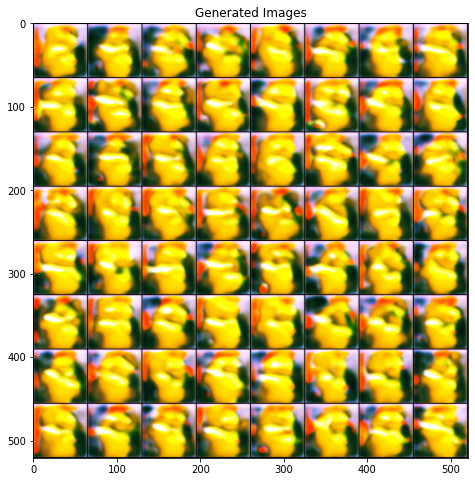

Epoch [21/2000], Step [32/32], Gen. Loss: 2.2602, Disc Loss: 0.3174
Epoch [22/2000], Step [32/32], Gen. Loss: 2.3948, Disc Loss: 0.3575
Epoch [23/2000], Step [32/32], Gen. Loss: 2.4478, Disc Loss: 0.2368
Epoch [24/2000], Step [32/32], Gen. Loss: 2.4234, Disc Loss: 0.4186
Epoch [25/2000], Step [32/32], Gen. Loss: 2.4543, Disc Loss: 0.2943
Epoch [26/2000], Step [32/32], Gen. Loss: 3.2366, Disc Loss: 0.1264
Epoch [27/2000], Step [32/32], Gen. Loss: 3.2828, Disc Loss: 0.1656
Epoch [28/2000], Step [32/32], Gen. Loss: 3.0809, Disc Loss: 0.2499
Epoch [29/2000], Step [32/32], Gen. Loss: 2.8785, Disc Loss: 0.2521
Epoch [30/2000], Step [32/32], Gen. Loss: 2.5035, Disc Loss: 0.2788
Epoch [31/2000], Step [32/32], Gen. Loss: 3.0512, Disc Loss: 0.1436
Epoch [32/2000], Step [32/32], Gen. Loss: 3.1722, Disc Loss: 0.1808
Epoch [33/2000], Step [32/32], Gen. Loss: 3.3053, Disc Loss: 0.1454
Epoch [34/2000], Step [32/32], Gen. Loss: 2.6961, Disc Loss: 0.3245
Epoch [35/2000], Step [32/32], Gen. Loss: 3.1967

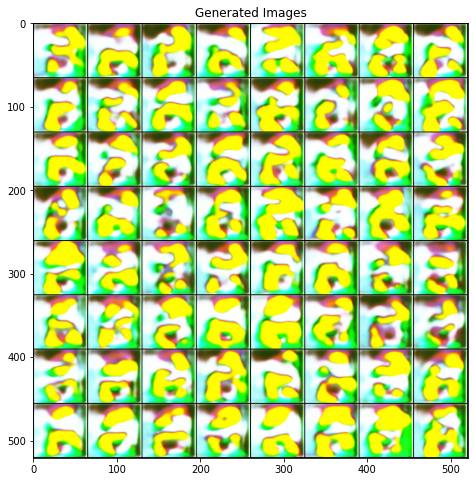

Epoch [41/2000], Step [32/32], Gen. Loss: 3.8837, Disc Loss: 0.0633
Epoch [42/2000], Step [32/32], Gen. Loss: 3.7177, Disc Loss: 0.0925
Epoch [43/2000], Step [32/32], Gen. Loss: 4.2744, Disc Loss: 0.0737
Epoch [44/2000], Step [32/32], Gen. Loss: 3.6039, Disc Loss: 0.1273
Epoch [45/2000], Step [32/32], Gen. Loss: 3.4970, Disc Loss: 0.1275
Epoch [46/2000], Step [32/32], Gen. Loss: 3.6248, Disc Loss: 0.1177
Epoch [47/2000], Step [32/32], Gen. Loss: 3.8751, Disc Loss: 0.0946
Epoch [48/2000], Step [32/32], Gen. Loss: 3.9087, Disc Loss: 0.1085
Epoch [49/2000], Step [32/32], Gen. Loss: 3.9931, Disc Loss: 0.1147
Epoch [50/2000], Step [32/32], Gen. Loss: 3.5757, Disc Loss: 0.1189
Epoch [51/2000], Step [32/32], Gen. Loss: 3.5993, Disc Loss: 0.1734
Epoch [52/2000], Step [32/32], Gen. Loss: 3.7097, Disc Loss: 0.1398
Epoch [53/2000], Step [32/32], Gen. Loss: 3.6694, Disc Loss: 0.1057
Epoch [54/2000], Step [32/32], Gen. Loss: 4.1495, Disc Loss: 0.0932
Epoch [55/2000], Step [32/32], Gen. Loss: 3.6521

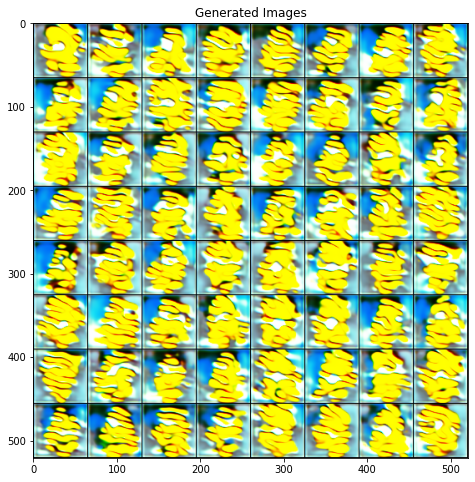

Epoch [61/2000], Step [32/32], Gen. Loss: 3.3684, Disc Loss: 0.2088
Epoch [62/2000], Step [32/32], Gen. Loss: 3.5548, Disc Loss: 0.1387
Epoch [63/2000], Step [32/32], Gen. Loss: 3.8538, Disc Loss: 0.1168
Epoch [64/2000], Step [32/32], Gen. Loss: 4.7718, Disc Loss: 0.0603
Epoch [65/2000], Step [32/32], Gen. Loss: 4.2862, Disc Loss: 0.0535
Epoch [66/2000], Step [32/32], Gen. Loss: 4.0283, Disc Loss: 0.0576
Epoch [67/2000], Step [32/32], Gen. Loss: 4.6851, Disc Loss: 0.0297
Epoch [68/2000], Step [32/32], Gen. Loss: 4.2159, Disc Loss: 0.0672
Epoch [69/2000], Step [32/32], Gen. Loss: 3.8907, Disc Loss: 0.0850
Epoch [70/2000], Step [32/32], Gen. Loss: 4.2867, Disc Loss: 0.0570
Epoch [71/2000], Step [32/32], Gen. Loss: 3.9267, Disc Loss: 0.0925
Epoch [72/2000], Step [32/32], Gen. Loss: 3.9012, Disc Loss: 0.0794
Epoch [73/2000], Step [32/32], Gen. Loss: 3.8819, Disc Loss: 0.0758
Epoch [74/2000], Step [32/32], Gen. Loss: 4.0848, Disc Loss: 0.0734
Epoch [75/2000], Step [32/32], Gen. Loss: 3.5750

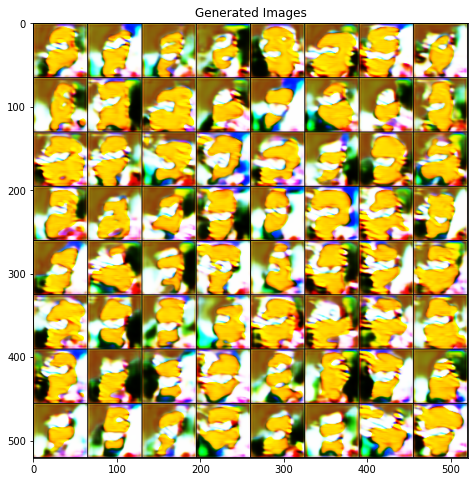

Epoch [81/2000], Step [32/32], Gen. Loss: 3.7507, Disc Loss: 0.1153
Epoch [82/2000], Step [32/32], Gen. Loss: 3.6443, Disc Loss: 0.0999
Epoch [83/2000], Step [32/32], Gen. Loss: 3.8368, Disc Loss: 0.0766
Epoch [84/2000], Step [32/32], Gen. Loss: 3.9808, Disc Loss: 0.1071
Epoch [85/2000], Step [32/32], Gen. Loss: 3.7573, Disc Loss: 0.1657
Epoch [86/2000], Step [32/32], Gen. Loss: 4.0949, Disc Loss: 0.1265
Epoch [87/2000], Step [32/32], Gen. Loss: 4.3622, Disc Loss: 0.0834
Epoch [88/2000], Step [32/32], Gen. Loss: 5.0503, Disc Loss: 0.0568
Epoch [89/2000], Step [32/32], Gen. Loss: 3.9531, Disc Loss: 0.0959
Epoch [90/2000], Step [32/32], Gen. Loss: 4.0181, Disc Loss: 0.0717
Epoch [91/2000], Step [32/32], Gen. Loss: 3.9344, Disc Loss: 0.1276
Epoch [92/2000], Step [32/32], Gen. Loss: 3.9676, Disc Loss: 0.1319
Epoch [93/2000], Step [32/32], Gen. Loss: 4.0481, Disc Loss: 0.0972
Epoch [94/2000], Step [32/32], Gen. Loss: 4.3677, Disc Loss: 0.0607
Epoch [95/2000], Step [32/32], Gen. Loss: 3.9689

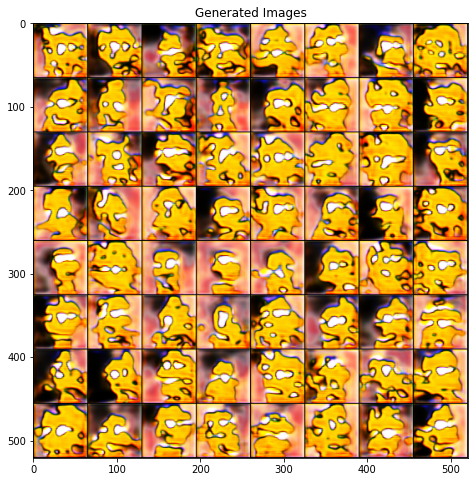

Epoch [101/2000], Step [32/32], Gen. Loss: 3.7815, Disc Loss: 0.0911
Epoch [102/2000], Step [32/32], Gen. Loss: 3.3935, Disc Loss: 0.1329
Epoch [103/2000], Step [32/32], Gen. Loss: 3.9978, Disc Loss: 0.0658
Epoch [104/2000], Step [32/32], Gen. Loss: 3.5750, Disc Loss: 0.1216
Epoch [105/2000], Step [32/32], Gen. Loss: 3.8953, Disc Loss: 0.1203
Epoch [106/2000], Step [32/32], Gen. Loss: 4.3244, Disc Loss: 0.0653
Epoch [107/2000], Step [32/32], Gen. Loss: 3.7485, Disc Loss: 0.1339
Epoch [108/2000], Step [32/32], Gen. Loss: 4.0012, Disc Loss: 0.1245
Epoch [109/2000], Step [32/32], Gen. Loss: 4.2940, Disc Loss: 0.1128
Epoch [110/2000], Step [32/32], Gen. Loss: 4.2310, Disc Loss: 0.1628
Epoch [111/2000], Step [32/32], Gen. Loss: 5.1204, Disc Loss: 0.0786
Epoch [112/2000], Step [32/32], Gen. Loss: 5.4007, Disc Loss: 0.0304
Epoch [113/2000], Step [32/32], Gen. Loss: 4.7765, Disc Loss: 0.0606
Epoch [114/2000], Step [32/32], Gen. Loss: 3.9839, Disc Loss: 0.0914
Epoch [115/2000], Step [32/32], Ge

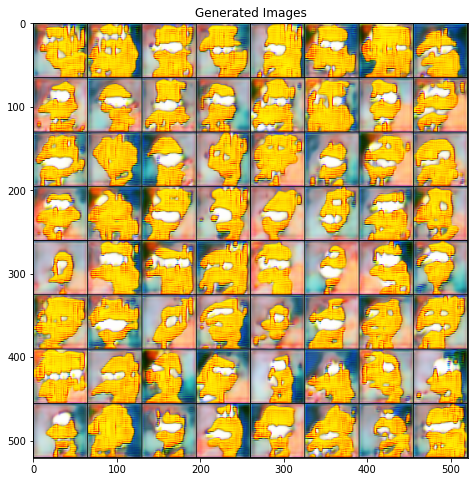

Epoch [121/2000], Step [32/32], Gen. Loss: 3.7794, Disc Loss: 0.1546
Epoch [122/2000], Step [32/32], Gen. Loss: 4.1332, Disc Loss: 0.0955
Epoch [123/2000], Step [32/32], Gen. Loss: 4.1136, Disc Loss: 0.0857
Epoch [124/2000], Step [32/32], Gen. Loss: 4.0992, Disc Loss: 0.0838
Epoch [125/2000], Step [32/32], Gen. Loss: 4.3588, Disc Loss: 0.0957
Epoch [126/2000], Step [32/32], Gen. Loss: 4.0012, Disc Loss: 0.1047
Epoch [127/2000], Step [32/32], Gen. Loss: 3.8742, Disc Loss: 0.1313
Epoch [128/2000], Step [32/32], Gen. Loss: 3.8397, Disc Loss: 0.1334
Epoch [129/2000], Step [32/32], Gen. Loss: 4.0791, Disc Loss: 0.1087
Epoch [130/2000], Step [32/32], Gen. Loss: 4.6587, Disc Loss: 0.0612
Epoch [131/2000], Step [32/32], Gen. Loss: 5.0120, Disc Loss: 0.0432
Epoch [132/2000], Step [32/32], Gen. Loss: 3.7264, Disc Loss: 0.1256
Epoch [133/2000], Step [32/32], Gen. Loss: 3.9304, Disc Loss: 0.1165
Epoch [134/2000], Step [32/32], Gen. Loss: 3.9275, Disc Loss: 0.1187
Epoch [135/2000], Step [32/32], Ge

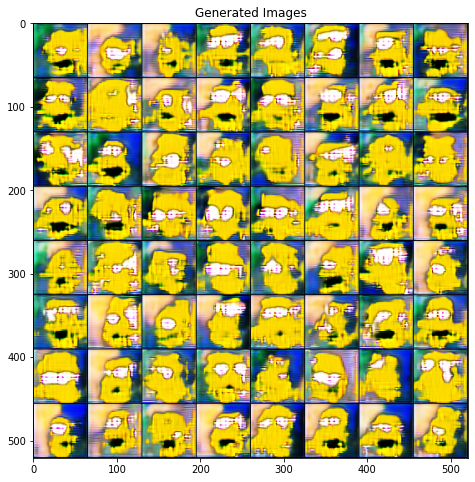

Epoch [141/2000], Step [32/32], Gen. Loss: 4.7163, Disc Loss: 0.0671
Epoch [142/2000], Step [32/32], Gen. Loss: 4.6075, Disc Loss: 0.0942
Epoch [143/2000], Step [32/32], Gen. Loss: 4.0129, Disc Loss: 0.1149
Epoch [144/2000], Step [32/32], Gen. Loss: 3.3774, Disc Loss: 0.2405
Epoch [145/2000], Step [32/32], Gen. Loss: 3.9062, Disc Loss: 0.1365
Epoch [146/2000], Step [32/32], Gen. Loss: 4.6299, Disc Loss: 0.0673
Epoch [147/2000], Step [32/32], Gen. Loss: 4.2356, Disc Loss: 0.0901
Epoch [148/2000], Step [32/32], Gen. Loss: 3.7858, Disc Loss: 0.1572
Epoch [149/2000], Step [32/32], Gen. Loss: 4.3518, Disc Loss: 0.1187
Epoch [150/2000], Step [32/32], Gen. Loss: 4.7315, Disc Loss: 0.0959
Epoch [151/2000], Step [32/32], Gen. Loss: 4.3486, Disc Loss: 0.0967
Epoch [152/2000], Step [32/32], Gen. Loss: 4.2762, Disc Loss: 0.0953
Epoch [153/2000], Step [32/32], Gen. Loss: 4.4978, Disc Loss: 0.0812
Epoch [154/2000], Step [32/32], Gen. Loss: 3.7312, Disc Loss: 0.1431
Epoch [155/2000], Step [32/32], Ge

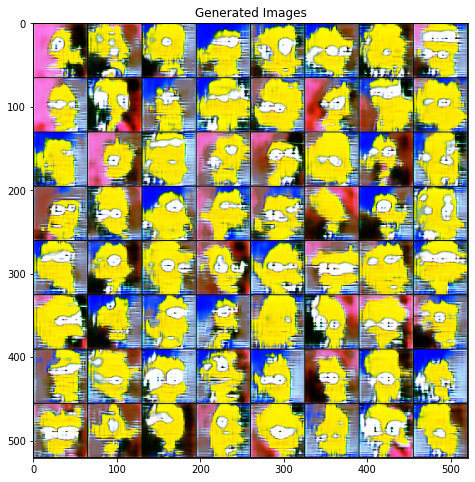

Epoch [161/2000], Step [32/32], Gen. Loss: 4.1992, Disc Loss: 0.0772
Epoch [162/2000], Step [32/32], Gen. Loss: 3.9577, Disc Loss: 0.0860
Epoch [163/2000], Step [32/32], Gen. Loss: 4.0986, Disc Loss: 0.0732
Epoch [164/2000], Step [32/32], Gen. Loss: 3.9656, Disc Loss: 0.1168
Epoch [165/2000], Step [32/32], Gen. Loss: 4.1686, Disc Loss: 0.0956
Epoch [166/2000], Step [32/32], Gen. Loss: 4.0311, Disc Loss: 0.1025
Epoch [167/2000], Step [32/32], Gen. Loss: 4.1166, Disc Loss: 0.0805
Epoch [168/2000], Step [32/32], Gen. Loss: 3.8176, Disc Loss: 0.1002
Epoch [169/2000], Step [32/32], Gen. Loss: 3.8116, Disc Loss: 0.0948
Epoch [170/2000], Step [32/32], Gen. Loss: 3.9273, Disc Loss: 0.0806
Epoch [171/2000], Step [32/32], Gen. Loss: 4.1095, Disc Loss: 0.0638
Epoch [172/2000], Step [32/32], Gen. Loss: 3.7495, Disc Loss: 0.0974
Epoch [173/2000], Step [32/32], Gen. Loss: 3.7301, Disc Loss: 0.1057
Epoch [174/2000], Step [32/32], Gen. Loss: 4.6066, Disc Loss: 0.0705
Epoch [175/2000], Step [32/32], Ge

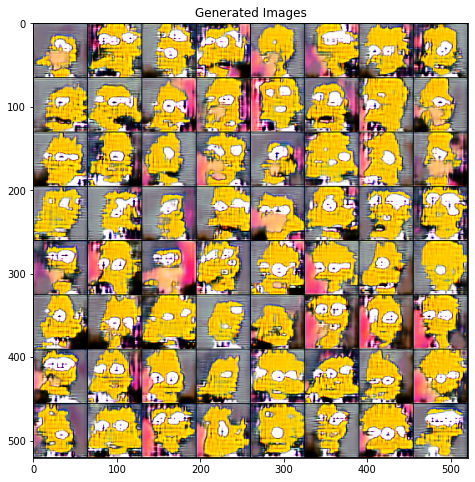

Epoch [181/2000], Step [32/32], Gen. Loss: 4.2326, Disc Loss: 0.0558
Epoch [182/2000], Step [32/32], Gen. Loss: 3.9636, Disc Loss: 0.0903
Epoch [183/2000], Step [32/32], Gen. Loss: 4.2600, Disc Loss: 0.0889
Epoch [184/2000], Step [32/32], Gen. Loss: 4.3372, Disc Loss: 0.0587
Epoch [185/2000], Step [32/32], Gen. Loss: 3.9344, Disc Loss: 0.0919
Epoch [186/2000], Step [32/32], Gen. Loss: 4.1896, Disc Loss: 0.0984
Epoch [187/2000], Step [32/32], Gen. Loss: 4.2173, Disc Loss: 0.0804
Epoch [188/2000], Step [32/32], Gen. Loss: 4.2057, Disc Loss: 0.0762
Epoch [189/2000], Step [32/32], Gen. Loss: 3.9179, Disc Loss: 0.1669
Epoch [190/2000], Step [32/32], Gen. Loss: 4.6783, Disc Loss: 0.1102
Epoch [191/2000], Step [32/32], Gen. Loss: 4.1367, Disc Loss: 0.1236
Epoch [192/2000], Step [32/32], Gen. Loss: 4.3542, Disc Loss: 0.0802
Epoch [193/2000], Step [32/32], Gen. Loss: 4.3399, Disc Loss: 0.0874
Epoch [194/2000], Step [32/32], Gen. Loss: 4.0251, Disc Loss: 0.0975
Epoch [195/2000], Step [32/32], Ge

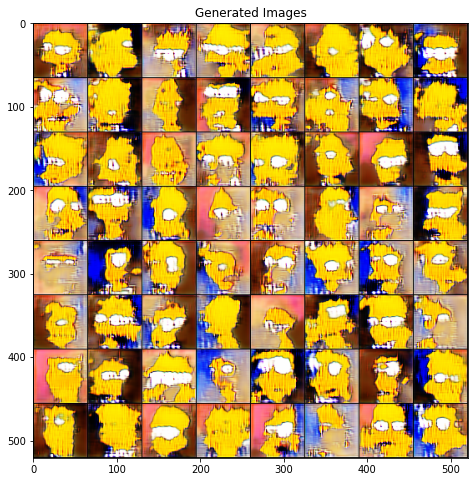

Epoch [201/2000], Step [32/32], Gen. Loss: 4.3484, Disc Loss: 0.0734
Epoch [202/2000], Step [32/32], Gen. Loss: 3.5771, Disc Loss: 0.1138
Epoch [203/2000], Step [32/32], Gen. Loss: 3.6252, Disc Loss: 0.1320
Epoch [204/2000], Step [32/32], Gen. Loss: 4.4763, Disc Loss: 0.1194
Epoch [205/2000], Step [32/32], Gen. Loss: 4.1381, Disc Loss: 0.1145
Epoch [206/2000], Step [32/32], Gen. Loss: 3.3659, Disc Loss: 0.1631
Epoch [207/2000], Step [32/32], Gen. Loss: 4.2118, Disc Loss: 0.0829
Epoch [208/2000], Step [32/32], Gen. Loss: 3.9069, Disc Loss: 0.0964
Epoch [209/2000], Step [32/32], Gen. Loss: 4.0366, Disc Loss: 0.0827
Epoch [210/2000], Step [32/32], Gen. Loss: 3.6335, Disc Loss: 0.1210
Epoch [211/2000], Step [32/32], Gen. Loss: 4.0133, Disc Loss: 0.1259
Epoch [212/2000], Step [32/32], Gen. Loss: 3.9039, Disc Loss: 0.1186
Epoch [213/2000], Step [32/32], Gen. Loss: 3.8102, Disc Loss: 0.1364
Epoch [214/2000], Step [32/32], Gen. Loss: 3.8116, Disc Loss: 0.1319
Epoch [215/2000], Step [32/32], Ge

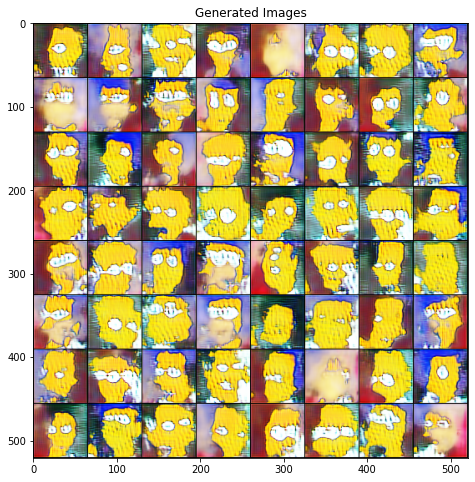

Epoch [221/2000], Step [32/32], Gen. Loss: 3.4350, Disc Loss: 0.1498
Epoch [222/2000], Step [32/32], Gen. Loss: 3.3685, Disc Loss: 0.1507
Epoch [223/2000], Step [32/32], Gen. Loss: 3.2485, Disc Loss: 0.1573
Epoch [224/2000], Step [32/32], Gen. Loss: 3.7054, Disc Loss: 0.1065
Epoch [225/2000], Step [32/32], Gen. Loss: 3.5677, Disc Loss: 0.1573
Epoch [226/2000], Step [32/32], Gen. Loss: 3.6045, Disc Loss: 0.1443
Epoch [227/2000], Step [32/32], Gen. Loss: 3.6901, Disc Loss: 0.2088
Epoch [228/2000], Step [32/32], Gen. Loss: 4.3114, Disc Loss: 0.1382
Epoch [229/2000], Step [32/32], Gen. Loss: 3.9399, Disc Loss: 0.1609
Epoch [230/2000], Step [32/32], Gen. Loss: 3.3331, Disc Loss: 0.1908
Epoch [231/2000], Step [32/32], Gen. Loss: 3.2594, Disc Loss: 0.1346
Epoch [232/2000], Step [32/32], Gen. Loss: 3.1544, Disc Loss: 0.1466
Epoch [233/2000], Step [32/32], Gen. Loss: 3.3173, Disc Loss: 0.1416
Epoch [234/2000], Step [32/32], Gen. Loss: 3.7767, Disc Loss: 0.1175
Epoch [235/2000], Step [32/32], Ge

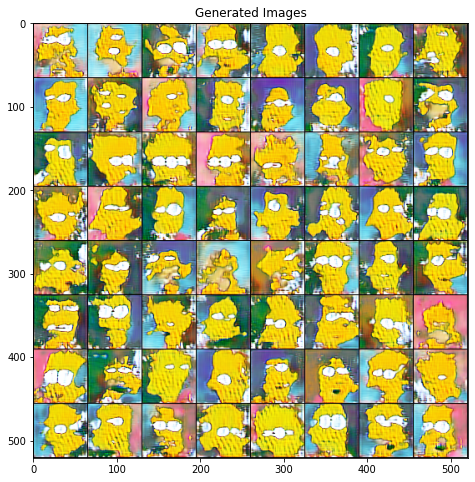

Epoch [241/2000], Step [32/32], Gen. Loss: 3.4252, Disc Loss: 0.1584
Epoch [242/2000], Step [32/32], Gen. Loss: 3.3485, Disc Loss: 0.1298
Epoch [243/2000], Step [32/32], Gen. Loss: 3.3572, Disc Loss: 0.1552
Epoch [244/2000], Step [32/32], Gen. Loss: 3.3584, Disc Loss: 0.1221
Epoch [245/2000], Step [32/32], Gen. Loss: 3.5431, Disc Loss: 0.0943
Epoch [246/2000], Step [32/32], Gen. Loss: 3.3330, Disc Loss: 0.1284
Epoch [247/2000], Step [32/32], Gen. Loss: 3.3876, Disc Loss: 0.1259
Epoch [248/2000], Step [32/32], Gen. Loss: 3.7852, Disc Loss: 0.1375
Epoch [249/2000], Step [32/32], Gen. Loss: 3.6993, Disc Loss: 0.1097
Epoch [250/2000], Step [32/32], Gen. Loss: 3.5360, Disc Loss: 0.0982
Epoch [251/2000], Step [32/32], Gen. Loss: 3.8153, Disc Loss: 0.0770
Epoch [252/2000], Step [32/32], Gen. Loss: 4.1276, Disc Loss: 0.0622
Epoch [253/2000], Step [32/32], Gen. Loss: 3.6265, Disc Loss: 0.0904
Epoch [254/2000], Step [32/32], Gen. Loss: 3.3752, Disc Loss: 0.1455
Epoch [255/2000], Step [32/32], Ge

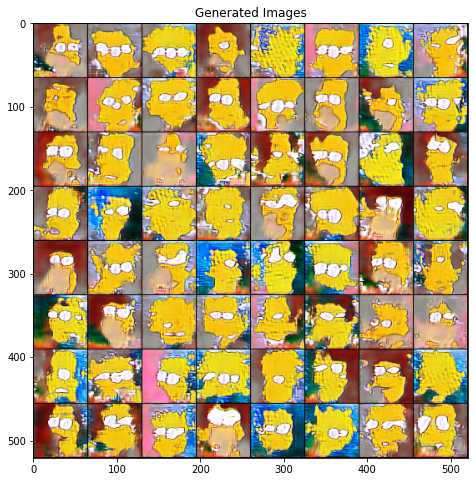

Epoch [261/2000], Step [32/32], Gen. Loss: 3.6047, Disc Loss: 0.1188
Epoch [262/2000], Step [32/32], Gen. Loss: 3.6398, Disc Loss: 0.0901
Epoch [263/2000], Step [32/32], Gen. Loss: 3.6378, Disc Loss: 0.0942
Epoch [264/2000], Step [32/32], Gen. Loss: 3.5609, Disc Loss: 0.0888
Epoch [265/2000], Step [32/32], Gen. Loss: 3.7858, Disc Loss: 0.0807
Epoch [266/2000], Step [32/32], Gen. Loss: 3.7894, Disc Loss: 0.0924
Epoch [267/2000], Step [32/32], Gen. Loss: 3.4632, Disc Loss: 0.1201
Epoch [268/2000], Step [32/32], Gen. Loss: 3.6142, Disc Loss: 0.1349
Epoch [269/2000], Step [32/32], Gen. Loss: 3.6587, Disc Loss: 0.1149
Epoch [270/2000], Step [32/32], Gen. Loss: 3.4069, Disc Loss: 0.1085
Epoch [271/2000], Step [32/32], Gen. Loss: 3.3834, Disc Loss: 0.1121
Epoch [272/2000], Step [32/32], Gen. Loss: 3.1873, Disc Loss: 0.1410
Epoch [273/2000], Step [32/32], Gen. Loss: 3.3582, Disc Loss: 0.1159
Epoch [274/2000], Step [32/32], Gen. Loss: 3.1048, Disc Loss: 0.1291
Epoch [275/2000], Step [32/32], Ge

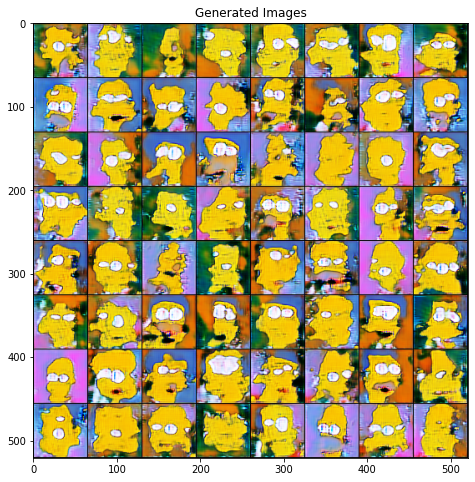

Epoch [281/2000], Step [32/32], Gen. Loss: 3.8607, Disc Loss: 0.1001
Epoch [282/2000], Step [32/32], Gen. Loss: 3.8564, Disc Loss: 0.0946
Epoch [283/2000], Step [32/32], Gen. Loss: 3.7862, Disc Loss: 0.0957
Epoch [284/2000], Step [32/32], Gen. Loss: 3.8269, Disc Loss: 0.0922
Epoch [285/2000], Step [32/32], Gen. Loss: 3.6320, Disc Loss: 0.1048
Epoch [286/2000], Step [32/32], Gen. Loss: 4.1610, Disc Loss: 0.1364
Epoch [287/2000], Step [32/32], Gen. Loss: 4.1371, Disc Loss: 0.0880
Epoch [288/2000], Step [32/32], Gen. Loss: 3.9873, Disc Loss: 0.0963
Epoch [289/2000], Step [32/32], Gen. Loss: 3.4179, Disc Loss: 0.1168
Epoch [290/2000], Step [32/32], Gen. Loss: 3.6035, Disc Loss: 0.1177
Epoch [291/2000], Step [32/32], Gen. Loss: 3.7004, Disc Loss: 0.1172
Epoch [292/2000], Step [32/32], Gen. Loss: 3.5333, Disc Loss: 0.1040
Epoch [293/2000], Step [32/32], Gen. Loss: 3.4285, Disc Loss: 0.1057
Epoch [294/2000], Step [32/32], Gen. Loss: 3.5856, Disc Loss: 0.1139
Epoch [295/2000], Step [32/32], Ge

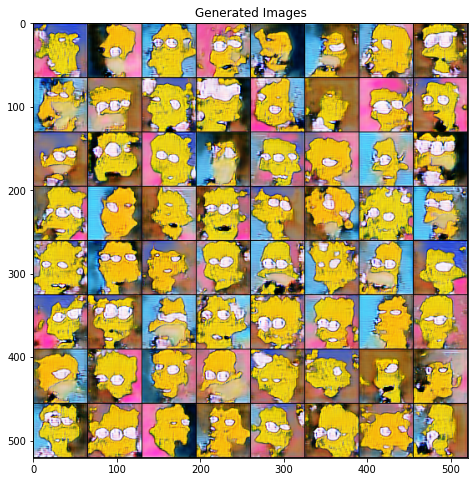

Epoch [301/2000], Step [32/32], Gen. Loss: 3.3535, Disc Loss: 0.1419
Epoch [302/2000], Step [32/32], Gen. Loss: 3.5968, Disc Loss: 0.1040
Epoch [303/2000], Step [32/32], Gen. Loss: 3.7431, Disc Loss: 0.1000
Epoch [304/2000], Step [32/32], Gen. Loss: 3.5138, Disc Loss: 0.1306
Epoch [305/2000], Step [32/32], Gen. Loss: 3.4404, Disc Loss: 0.1224
Epoch [306/2000], Step [32/32], Gen. Loss: 3.3525, Disc Loss: 0.1103
Epoch [307/2000], Step [32/32], Gen. Loss: 3.4426, Disc Loss: 0.0959
Epoch [308/2000], Step [32/32], Gen. Loss: 3.3455, Disc Loss: 0.1174
Epoch [309/2000], Step [32/32], Gen. Loss: 3.3937, Disc Loss: 0.1231
Epoch [310/2000], Step [32/32], Gen. Loss: 3.5821, Disc Loss: 0.1151
Epoch [311/2000], Step [32/32], Gen. Loss: 3.6277, Disc Loss: 0.0982
Epoch [312/2000], Step [32/32], Gen. Loss: 3.4780, Disc Loss: 0.0951
Epoch [313/2000], Step [32/32], Gen. Loss: 3.2076, Disc Loss: 0.1129
Epoch [314/2000], Step [32/32], Gen. Loss: 3.3559, Disc Loss: 0.0989
Epoch [315/2000], Step [32/32], Ge

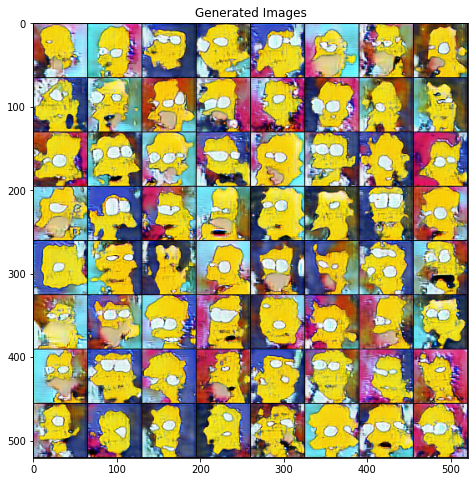

Epoch [321/2000], Step [32/32], Gen. Loss: 3.2517, Disc Loss: 0.1300
Epoch [322/2000], Step [32/32], Gen. Loss: 3.4302, Disc Loss: 0.1107
Epoch [323/2000], Step [32/32], Gen. Loss: 2.9996, Disc Loss: 0.1459
Epoch [324/2000], Step [32/32], Gen. Loss: 3.3941, Disc Loss: 0.1056
Epoch [325/2000], Step [32/32], Gen. Loss: 3.5831, Disc Loss: 0.0942
Epoch [326/2000], Step [32/32], Gen. Loss: 3.5915, Disc Loss: 0.0993
Epoch [327/2000], Step [32/32], Gen. Loss: 3.5481, Disc Loss: 0.0924
Epoch [328/2000], Step [32/32], Gen. Loss: 3.5209, Disc Loss: 0.0953
Epoch [329/2000], Step [32/32], Gen. Loss: 3.4991, Disc Loss: 0.1314
Epoch [330/2000], Step [32/32], Gen. Loss: 3.8921, Disc Loss: 0.1918
Epoch [331/2000], Step [32/32], Gen. Loss: 3.8047, Disc Loss: 0.1455
Epoch [332/2000], Step [32/32], Gen. Loss: 3.7375, Disc Loss: 0.1839
Epoch [333/2000], Step [32/32], Gen. Loss: 3.8771, Disc Loss: 0.1647
Epoch [334/2000], Step [32/32], Gen. Loss: 4.1111, Disc Loss: 0.0941
Epoch [335/2000], Step [32/32], Ge

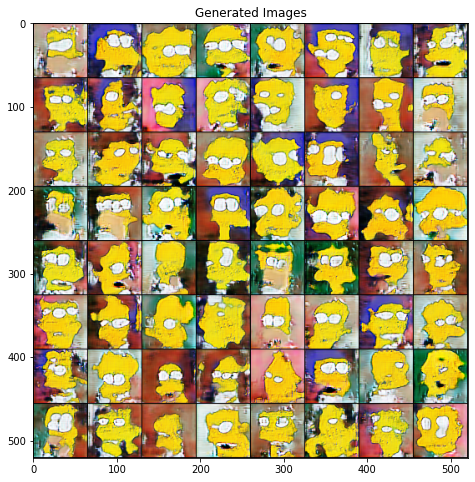

Epoch [341/2000], Step [32/32], Gen. Loss: 3.2315, Disc Loss: 0.1327
Epoch [342/2000], Step [32/32], Gen. Loss: 3.3344, Disc Loss: 0.1172
Epoch [343/2000], Step [32/32], Gen. Loss: 3.3212, Disc Loss: 0.1244
Epoch [344/2000], Step [32/32], Gen. Loss: 3.2620, Disc Loss: 0.1032
Epoch [345/2000], Step [32/32], Gen. Loss: 3.2363, Disc Loss: 0.1133
Epoch [346/2000], Step [32/32], Gen. Loss: 3.3631, Disc Loss: 0.1234
Epoch [347/2000], Step [32/32], Gen. Loss: 3.2093, Disc Loss: 0.1269
Epoch [348/2000], Step [32/32], Gen. Loss: 3.4789, Disc Loss: 0.1034
Epoch [349/2000], Step [32/32], Gen. Loss: 3.2292, Disc Loss: 0.1250
Epoch [350/2000], Step [32/32], Gen. Loss: 3.1838, Disc Loss: 0.1185
Epoch [351/2000], Step [32/32], Gen. Loss: 3.5307, Disc Loss: 0.1023
Epoch [352/2000], Step [32/32], Gen. Loss: 3.2617, Disc Loss: 0.1782
Epoch [353/2000], Step [32/32], Gen. Loss: 3.2742, Disc Loss: 0.1478
Epoch [354/2000], Step [32/32], Gen. Loss: 3.4924, Disc Loss: 0.1147
Epoch [355/2000], Step [32/32], Ge

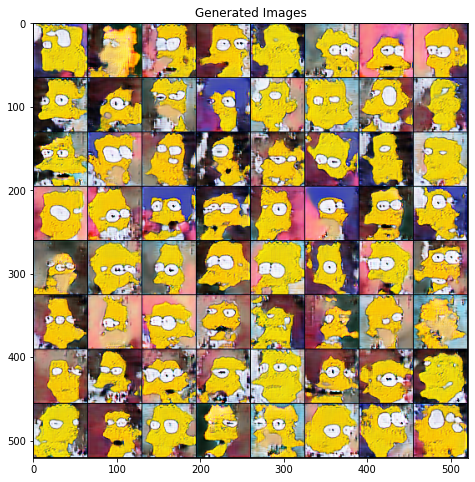

Epoch [361/2000], Step [32/32], Gen. Loss: 3.4206, Disc Loss: 0.1367
Epoch [362/2000], Step [32/32], Gen. Loss: 3.0847, Disc Loss: 0.1464
Epoch [363/2000], Step [32/32], Gen. Loss: 3.7550, Disc Loss: 0.1434
Epoch [364/2000], Step [32/32], Gen. Loss: 3.4071, Disc Loss: 0.1175
Epoch [365/2000], Step [32/32], Gen. Loss: 3.4402, Disc Loss: 0.1323
Epoch [366/2000], Step [32/32], Gen. Loss: 3.6576, Disc Loss: 0.1065
Epoch [367/2000], Step [32/32], Gen. Loss: 3.5189, Disc Loss: 0.1062
Epoch [368/2000], Step [32/32], Gen. Loss: 3.1727, Disc Loss: 0.1185
Epoch [369/2000], Step [32/32], Gen. Loss: 3.2564, Disc Loss: 0.1282
Epoch [370/2000], Step [32/32], Gen. Loss: 3.6255, Disc Loss: 0.0905
Epoch [371/2000], Step [32/32], Gen. Loss: 3.3463, Disc Loss: 0.1076
Epoch [372/2000], Step [32/32], Gen. Loss: 3.2691, Disc Loss: 0.1317
Epoch [373/2000], Step [32/32], Gen. Loss: 3.6572, Disc Loss: 0.0896
Epoch [374/2000], Step [32/32], Gen. Loss: 3.3490, Disc Loss: 0.0968
Epoch [375/2000], Step [32/32], Ge

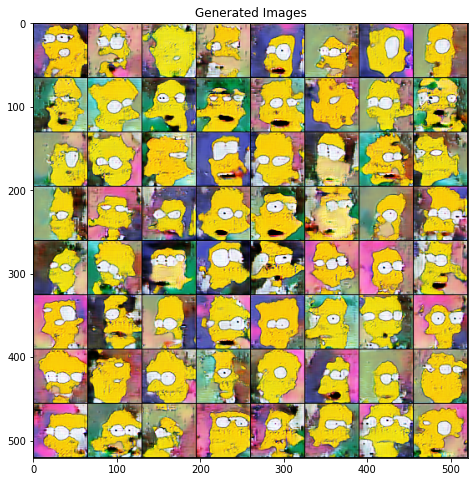

Epoch [381/2000], Step [32/32], Gen. Loss: 3.5703, Disc Loss: 0.0986
Epoch [382/2000], Step [32/32], Gen. Loss: 3.4753, Disc Loss: 0.1114
Epoch [383/2000], Step [32/32], Gen. Loss: 3.3726, Disc Loss: 0.1683
Epoch [384/2000], Step [32/32], Gen. Loss: 3.3975, Disc Loss: 0.1422
Epoch [385/2000], Step [32/32], Gen. Loss: 3.1815, Disc Loss: 0.1317
Epoch [386/2000], Step [32/32], Gen. Loss: 3.1355, Disc Loss: 0.1401
Epoch [387/2000], Step [32/32], Gen. Loss: 3.2600, Disc Loss: 0.1032
Epoch [388/2000], Step [32/32], Gen. Loss: 3.2928, Disc Loss: 0.1137
Epoch [389/2000], Step [32/32], Gen. Loss: 3.5509, Disc Loss: 0.0940
Epoch [390/2000], Step [32/32], Gen. Loss: 3.6856, Disc Loss: 0.0768
Epoch [391/2000], Step [32/32], Gen. Loss: 3.6171, Disc Loss: 0.0875
Epoch [392/2000], Step [32/32], Gen. Loss: 3.9870, Disc Loss: 0.0562
Epoch [393/2000], Step [32/32], Gen. Loss: 3.9564, Disc Loss: 0.0803
Epoch [394/2000], Step [32/32], Gen. Loss: 3.8134, Disc Loss: 0.0816
Epoch [395/2000], Step [32/32], Ge

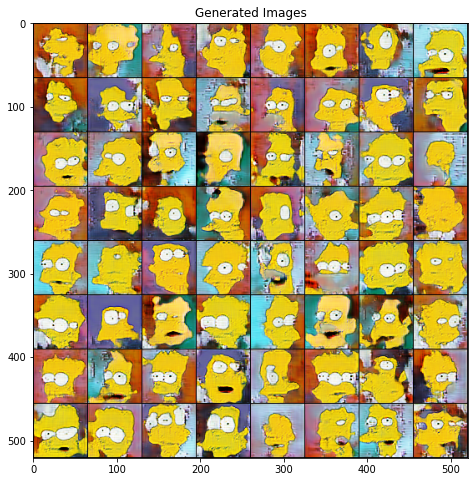

Epoch [401/2000], Step [32/32], Gen. Loss: 3.7165, Disc Loss: 0.0877
Epoch [402/2000], Step [32/32], Gen. Loss: 3.6415, Disc Loss: 0.0877
Epoch [403/2000], Step [32/32], Gen. Loss: 3.6697, Disc Loss: 0.0817
Epoch [404/2000], Step [32/32], Gen. Loss: 3.7286, Disc Loss: 0.0822
Epoch [405/2000], Step [32/32], Gen. Loss: 3.5157, Disc Loss: 0.0970
Epoch [406/2000], Step [32/32], Gen. Loss: 3.6943, Disc Loss: 0.0838
Epoch [407/2000], Step [32/32], Gen. Loss: 3.6675, Disc Loss: 0.0883
Epoch [408/2000], Step [32/32], Gen. Loss: 3.3773, Disc Loss: 0.1230
Epoch [409/2000], Step [32/32], Gen. Loss: 3.6726, Disc Loss: 0.0866
Epoch [410/2000], Step [32/32], Gen. Loss: 3.8317, Disc Loss: 0.0805
Epoch [411/2000], Step [32/32], Gen. Loss: 3.4640, Disc Loss: 0.0916
Epoch [412/2000], Step [32/32], Gen. Loss: 3.6033, Disc Loss: 0.0883
Epoch [413/2000], Step [32/32], Gen. Loss: 3.5065, Disc Loss: 0.0860
Epoch [414/2000], Step [32/32], Gen. Loss: 3.5230, Disc Loss: 0.0974
Epoch [415/2000], Step [32/32], Ge

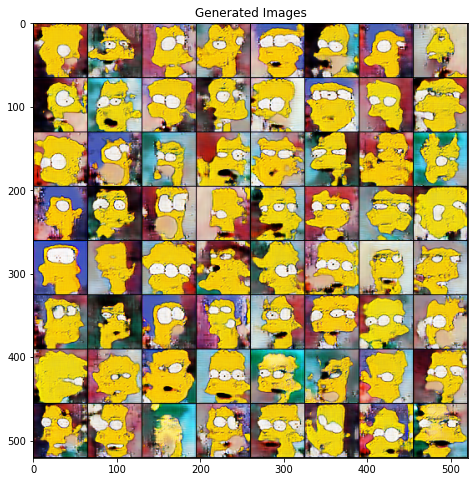

Epoch [421/2000], Step [32/32], Gen. Loss: 3.5567, Disc Loss: 0.0808
Epoch [422/2000], Step [32/32], Gen. Loss: 3.5856, Disc Loss: 0.0896
Epoch [423/2000], Step [32/32], Gen. Loss: 3.2037, Disc Loss: 0.1138
Epoch [424/2000], Step [32/32], Gen. Loss: 3.3664, Disc Loss: 0.1043
Epoch [425/2000], Step [32/32], Gen. Loss: 3.2785, Disc Loss: 0.1043
Epoch [426/2000], Step [32/32], Gen. Loss: 3.6635, Disc Loss: 0.0874
Epoch [427/2000], Step [32/32], Gen. Loss: 3.6699, Disc Loss: 0.1004
Epoch [428/2000], Step [32/32], Gen. Loss: 3.5433, Disc Loss: 0.0917
Epoch [429/2000], Step [32/32], Gen. Loss: 3.4304, Disc Loss: 0.0954
Epoch [430/2000], Step [32/32], Gen. Loss: 3.5108, Disc Loss: 0.1031
Epoch [431/2000], Step [32/32], Gen. Loss: 3.3638, Disc Loss: 0.1047
Epoch [432/2000], Step [32/32], Gen. Loss: 3.4456, Disc Loss: 0.1048
Epoch [433/2000], Step [32/32], Gen. Loss: 3.4882, Disc Loss: 0.0875
Epoch [434/2000], Step [32/32], Gen. Loss: 3.4775, Disc Loss: 0.1033
Epoch [435/2000], Step [32/32], Ge

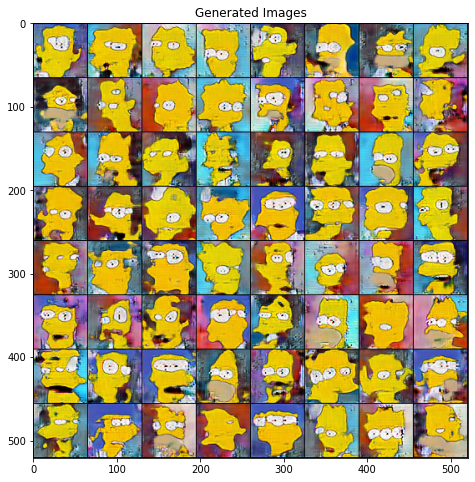

Epoch [441/2000], Step [32/32], Gen. Loss: 3.4283, Disc Loss: 0.0999
Epoch [442/2000], Step [32/32], Gen. Loss: 3.2565, Disc Loss: 0.1064
Epoch [443/2000], Step [32/32], Gen. Loss: 3.5062, Disc Loss: 0.0975
Epoch [444/2000], Step [32/32], Gen. Loss: 3.7064, Disc Loss: 0.0925
Epoch [445/2000], Step [32/32], Gen. Loss: 3.6307, Disc Loss: 0.0793
Epoch [446/2000], Step [32/32], Gen. Loss: 3.4697, Disc Loss: 0.0858
Epoch [447/2000], Step [32/32], Gen. Loss: 3.5185, Disc Loss: 0.0810
Epoch [448/2000], Step [32/32], Gen. Loss: 3.5668, Disc Loss: 0.0814
Epoch [449/2000], Step [32/32], Gen. Loss: 3.4493, Disc Loss: 0.0828
Epoch [450/2000], Step [32/32], Gen. Loss: 3.5278, Disc Loss: 0.0875
Epoch [451/2000], Step [32/32], Gen. Loss: 3.5011, Disc Loss: 0.1028
Epoch [452/2000], Step [32/32], Gen. Loss: 3.4211, Disc Loss: 0.0867
Epoch [453/2000], Step [32/32], Gen. Loss: 3.7186, Disc Loss: 0.0711
Epoch [454/2000], Step [32/32], Gen. Loss: 3.7273, Disc Loss: 0.0694
Epoch [455/2000], Step [32/32], Ge

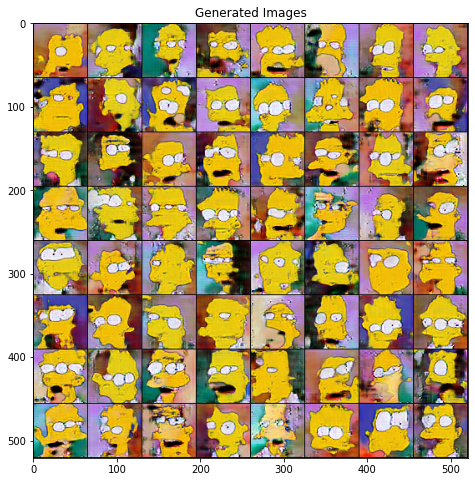

Epoch [461/2000], Step [32/32], Gen. Loss: 3.8047, Disc Loss: 0.0794
Epoch [462/2000], Step [32/32], Gen. Loss: 3.7254, Disc Loss: 0.0751
Epoch [463/2000], Step [32/32], Gen. Loss: 3.6954, Disc Loss: 0.0859
Epoch [464/2000], Step [32/32], Gen. Loss: 3.5374, Disc Loss: 0.0915
Epoch [465/2000], Step [32/32], Gen. Loss: 3.7147, Disc Loss: 0.0851
Epoch [466/2000], Step [32/32], Gen. Loss: 3.5585, Disc Loss: 0.0868
Epoch [467/2000], Step [32/32], Gen. Loss: 3.6500, Disc Loss: 0.0779
Epoch [468/2000], Step [32/32], Gen. Loss: 3.7389, Disc Loss: 0.0612
Epoch [469/2000], Step [32/32], Gen. Loss: 3.5276, Disc Loss: 0.0799
Epoch [470/2000], Step [32/32], Gen. Loss: 3.4311, Disc Loss: 0.0846
Epoch [471/2000], Step [32/32], Gen. Loss: 3.5203, Disc Loss: 0.0826
Epoch [472/2000], Step [32/32], Gen. Loss: 3.6652, Disc Loss: 0.0813
Epoch [473/2000], Step [32/32], Gen. Loss: 3.3934, Disc Loss: 0.1015
Epoch [474/2000], Step [32/32], Gen. Loss: 3.4242, Disc Loss: 0.0914
Epoch [475/2000], Step [32/32], Ge

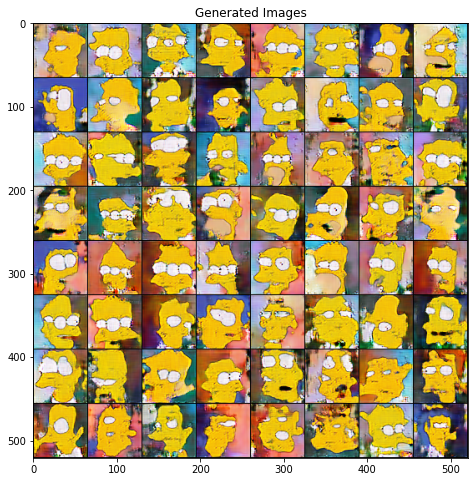

Epoch [481/2000], Step [32/32], Gen. Loss: 3.5491, Disc Loss: 0.1390
Epoch [482/2000], Step [32/32], Gen. Loss: 3.5240, Disc Loss: 0.1153
Epoch [483/2000], Step [32/32], Gen. Loss: 3.5341, Disc Loss: 0.0942
Epoch [484/2000], Step [32/32], Gen. Loss: 3.3015, Disc Loss: 0.1019
Epoch [485/2000], Step [32/32], Gen. Loss: 3.5634, Disc Loss: 0.0750
Epoch [486/2000], Step [32/32], Gen. Loss: 3.7027, Disc Loss: 0.0656
Epoch [487/2000], Step [32/32], Gen. Loss: 3.5814, Disc Loss: 0.0720
Epoch [488/2000], Step [32/32], Gen. Loss: 3.4321, Disc Loss: 0.0876
Epoch [489/2000], Step [32/32], Gen. Loss: 3.4875, Disc Loss: 0.0747
Epoch [490/2000], Step [32/32], Gen. Loss: 3.6469, Disc Loss: 0.0651
Epoch [491/2000], Step [32/32], Gen. Loss: 3.4573, Disc Loss: 0.0715
Epoch [492/2000], Step [32/32], Gen. Loss: 3.5257, Disc Loss: 0.0765
Epoch [493/2000], Step [32/32], Gen. Loss: 3.8842, Disc Loss: 0.0759
Epoch [494/2000], Step [32/32], Gen. Loss: 3.6376, Disc Loss: 0.0920
Epoch [495/2000], Step [32/32], Ge

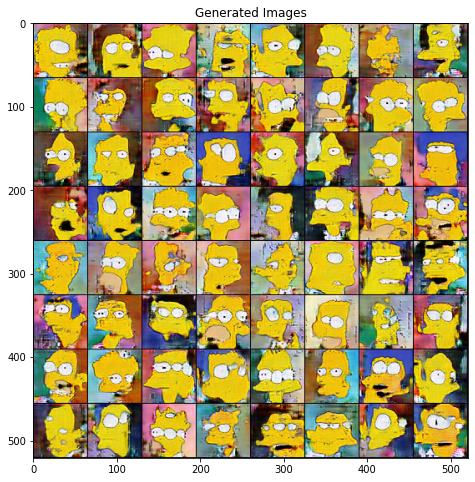

Epoch [501/2000], Step [32/32], Gen. Loss: 3.5637, Disc Loss: 0.0790
Epoch [502/2000], Step [32/32], Gen. Loss: 3.6615, Disc Loss: 0.0769
Epoch [503/2000], Step [32/32], Gen. Loss: 3.5646, Disc Loss: 0.0786
Epoch [504/2000], Step [32/32], Gen. Loss: 3.5332, Disc Loss: 0.0737
Epoch [505/2000], Step [32/32], Gen. Loss: 3.4295, Disc Loss: 0.0808
Epoch [506/2000], Step [32/32], Gen. Loss: 3.6088, Disc Loss: 0.0706
Epoch [507/2000], Step [32/32], Gen. Loss: 3.5924, Disc Loss: 0.0750
Epoch [508/2000], Step [32/32], Gen. Loss: 3.4835, Disc Loss: 0.0840
Epoch [509/2000], Step [32/32], Gen. Loss: 3.4739, Disc Loss: 0.1082
Epoch [510/2000], Step [32/32], Gen. Loss: 3.5825, Disc Loss: 0.0944
Epoch [511/2000], Step [32/32], Gen. Loss: 3.4647, Disc Loss: 0.0849
Epoch [512/2000], Step [32/32], Gen. Loss: 3.6097, Disc Loss: 0.0709
Epoch [513/2000], Step [32/32], Gen. Loss: 3.4664, Disc Loss: 0.0814
Epoch [514/2000], Step [32/32], Gen. Loss: 3.5054, Disc Loss: 0.0834
Epoch [515/2000], Step [32/32], Ge

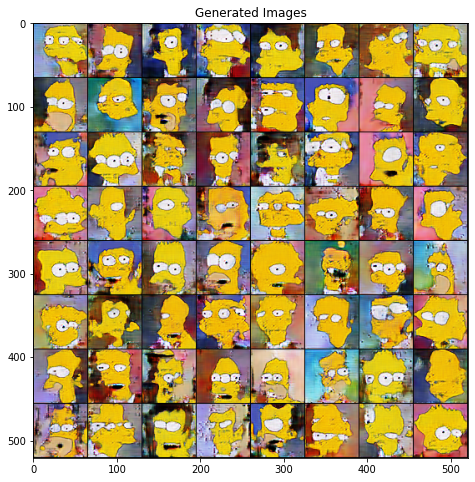

Epoch [521/2000], Step [32/32], Gen. Loss: 3.7016, Disc Loss: 0.0677
Epoch [522/2000], Step [32/32], Gen. Loss: 3.6102, Disc Loss: 0.0686
Epoch [523/2000], Step [32/32], Gen. Loss: 3.5935, Disc Loss: 0.0705
Epoch [524/2000], Step [32/32], Gen. Loss: 3.6217, Disc Loss: 0.0753
Epoch [525/2000], Step [32/32], Gen. Loss: 3.5740, Disc Loss: 0.0751
Epoch [526/2000], Step [32/32], Gen. Loss: 3.6894, Disc Loss: 0.0761
Epoch [527/2000], Step [32/32], Gen. Loss: 3.6538, Disc Loss: 0.0750
Epoch [528/2000], Step [32/32], Gen. Loss: 3.6350, Disc Loss: 0.0735
Epoch [529/2000], Step [32/32], Gen. Loss: 3.7553, Disc Loss: 0.0665
Epoch [530/2000], Step [32/32], Gen. Loss: 3.6859, Disc Loss: 0.0637
Epoch [531/2000], Step [32/32], Gen. Loss: 3.7097, Disc Loss: 0.0633
Epoch [532/2000], Step [32/32], Gen. Loss: 3.8068, Disc Loss: 0.0633
Epoch [533/2000], Step [32/32], Gen. Loss: 3.6741, Disc Loss: 0.0647
Epoch [534/2000], Step [32/32], Gen. Loss: 3.5929, Disc Loss: 0.0683
Epoch [535/2000], Step [32/32], Ge

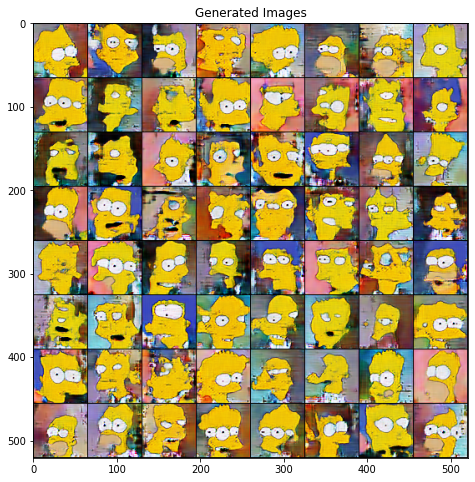

Epoch [541/2000], Step [32/32], Gen. Loss: 3.7650, Disc Loss: 0.0636
Epoch [542/2000], Step [32/32], Gen. Loss: 3.7848, Disc Loss: 0.0805
Epoch [543/2000], Step [32/32], Gen. Loss: 3.6409, Disc Loss: 0.0949
Epoch [544/2000], Step [32/32], Gen. Loss: 3.6729, Disc Loss: 0.0812
Epoch [545/2000], Step [32/32], Gen. Loss: 3.8168, Disc Loss: 0.0612
Epoch [546/2000], Step [32/32], Gen. Loss: 3.7430, Disc Loss: 0.0644
Epoch [547/2000], Step [32/32], Gen. Loss: 3.9116, Disc Loss: 0.0655
Epoch [548/2000], Step [32/32], Gen. Loss: 3.6941, Disc Loss: 0.0678
Epoch [549/2000], Step [32/32], Gen. Loss: 3.8740, Disc Loss: 0.0591
Epoch [550/2000], Step [32/32], Gen. Loss: 3.9563, Disc Loss: 0.0557
Epoch [551/2000], Step [32/32], Gen. Loss: 3.9613, Disc Loss: 0.0528
Epoch [552/2000], Step [32/32], Gen. Loss: 3.8401, Disc Loss: 0.0560
Epoch [553/2000], Step [32/32], Gen. Loss: 3.8866, Disc Loss: 0.0562
Epoch [554/2000], Step [32/32], Gen. Loss: 3.8447, Disc Loss: 0.0611
Epoch [555/2000], Step [32/32], Ge

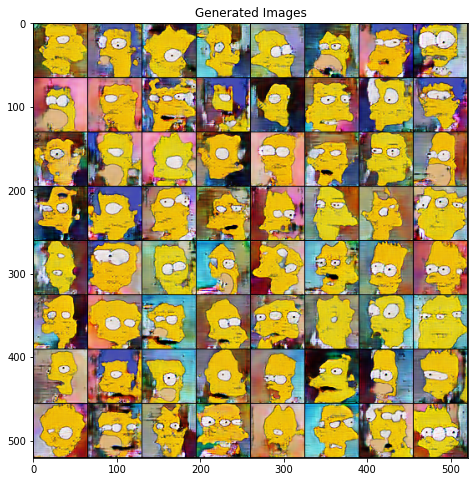

Epoch [561/2000], Step [32/32], Gen. Loss: 3.9276, Disc Loss: 0.0544
Epoch [562/2000], Step [32/32], Gen. Loss: 3.9108, Disc Loss: 0.0597
Epoch [563/2000], Step [32/32], Gen. Loss: 3.9506, Disc Loss: 0.0665
Epoch [564/2000], Step [32/32], Gen. Loss: 3.9302, Disc Loss: 0.0552
Epoch [565/2000], Step [32/32], Gen. Loss: 3.8809, Disc Loss: 0.0594
Epoch [566/2000], Step [32/32], Gen. Loss: 3.8852, Disc Loss: 0.0708
Epoch [567/2000], Step [32/32], Gen. Loss: 3.9627, Disc Loss: 0.0696
Epoch [568/2000], Step [32/32], Gen. Loss: 3.9349, Disc Loss: 0.0583
Epoch [569/2000], Step [32/32], Gen. Loss: 3.8908, Disc Loss: 0.0629
Epoch [570/2000], Step [32/32], Gen. Loss: 3.8632, Disc Loss: 0.0749
Epoch [571/2000], Step [32/32], Gen. Loss: 3.7792, Disc Loss: 0.0567
Epoch [572/2000], Step [32/32], Gen. Loss: 4.0628, Disc Loss: 0.0504
Epoch [573/2000], Step [32/32], Gen. Loss: 4.0387, Disc Loss: 0.0491
Epoch [574/2000], Step [32/32], Gen. Loss: 4.1753, Disc Loss: 0.0627
Epoch [575/2000], Step [32/32], Ge

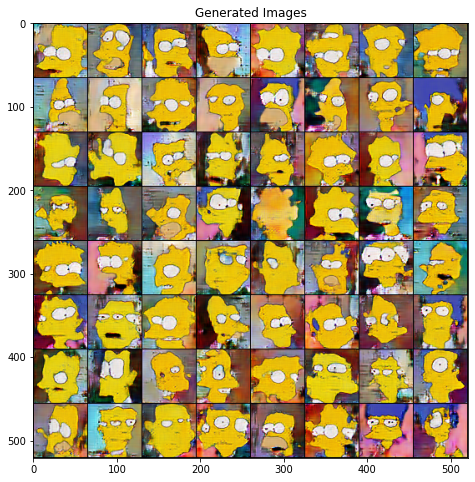

Epoch [581/2000], Step [32/32], Gen. Loss: 4.0585, Disc Loss: 0.0553
Epoch [582/2000], Step [32/32], Gen. Loss: 4.0254, Disc Loss: 0.0502
Epoch [583/2000], Step [32/32], Gen. Loss: 3.9193, Disc Loss: 0.0525
Epoch [584/2000], Step [32/32], Gen. Loss: 3.9379, Disc Loss: 0.0519
Epoch [585/2000], Step [32/32], Gen. Loss: 3.9649, Disc Loss: 0.0597
Epoch [586/2000], Step [32/32], Gen. Loss: 4.0100, Disc Loss: 0.0578
Epoch [587/2000], Step [32/32], Gen. Loss: 4.0149, Disc Loss: 0.0491
Epoch [588/2000], Step [32/32], Gen. Loss: 4.0964, Disc Loss: 0.0441
Epoch [589/2000], Step [32/32], Gen. Loss: 4.1451, Disc Loss: 0.0479
Epoch [590/2000], Step [32/32], Gen. Loss: 4.0957, Disc Loss: 0.0644
Epoch [591/2000], Step [32/32], Gen. Loss: 4.1736, Disc Loss: 0.0748
Epoch [592/2000], Step [32/32], Gen. Loss: 4.0306, Disc Loss: 0.0589
Epoch [593/2000], Step [32/32], Gen. Loss: 4.0949, Disc Loss: 0.0545
Epoch [594/2000], Step [32/32], Gen. Loss: 4.0296, Disc Loss: 0.0637
Epoch [595/2000], Step [32/32], Ge

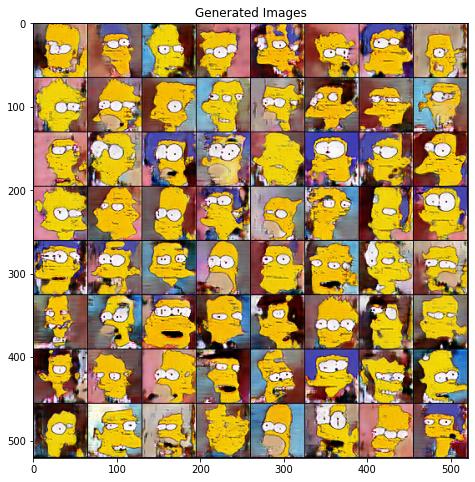

Epoch [601/2000], Step [32/32], Gen. Loss: 4.2803, Disc Loss: 0.0464
Epoch [602/2000], Step [32/32], Gen. Loss: 4.3069, Disc Loss: 0.0441
Epoch [603/2000], Step [32/32], Gen. Loss: 4.1657, Disc Loss: 0.0557
Epoch [604/2000], Step [32/32], Gen. Loss: 4.2163, Disc Loss: 0.0480
Epoch [605/2000], Step [32/32], Gen. Loss: 4.1158, Disc Loss: 0.0489
Epoch [606/2000], Step [32/32], Gen. Loss: 4.0120, Disc Loss: 0.0464
Epoch [607/2000], Step [32/32], Gen. Loss: 4.0158, Disc Loss: 0.0450
Epoch [608/2000], Step [32/32], Gen. Loss: 4.0550, Disc Loss: 0.0501
Epoch [609/2000], Step [32/32], Gen. Loss: 4.1579, Disc Loss: 0.0505
Epoch [610/2000], Step [32/32], Gen. Loss: 4.0269, Disc Loss: 0.0576
Epoch [611/2000], Step [32/32], Gen. Loss: 3.9547, Disc Loss: 0.0573
Epoch [612/2000], Step [32/32], Gen. Loss: 4.0830, Disc Loss: 0.0529
Epoch [613/2000], Step [32/32], Gen. Loss: 4.0867, Disc Loss: 0.0592
Epoch [614/2000], Step [32/32], Gen. Loss: 3.9718, Disc Loss: 0.0576
Epoch [615/2000], Step [32/32], Ge

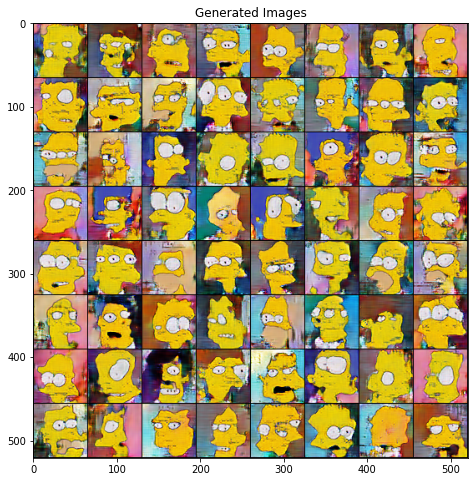

Epoch [621/2000], Step [32/32], Gen. Loss: 4.2375, Disc Loss: 0.0465
Epoch [622/2000], Step [32/32], Gen. Loss: 4.2547, Disc Loss: 0.0442
Epoch [623/2000], Step [32/32], Gen. Loss: 4.0406, Disc Loss: 0.0475
Epoch [624/2000], Step [32/32], Gen. Loss: 4.0142, Disc Loss: 0.0495
Epoch [625/2000], Step [32/32], Gen. Loss: 4.1077, Disc Loss: 0.0434
Epoch [626/2000], Step [32/32], Gen. Loss: 4.2060, Disc Loss: 0.0487
Epoch [627/2000], Step [32/32], Gen. Loss: 4.0142, Disc Loss: 0.0564
Epoch [628/2000], Step [32/32], Gen. Loss: 4.3389, Disc Loss: 0.0483
Epoch [629/2000], Step [32/32], Gen. Loss: 4.2091, Disc Loss: 0.0401
Epoch [630/2000], Step [32/32], Gen. Loss: 4.3186, Disc Loss: 0.0386
Epoch [631/2000], Step [32/32], Gen. Loss: 4.2155, Disc Loss: 0.0466
Epoch [632/2000], Step [32/32], Gen. Loss: 4.1796, Disc Loss: 0.0448
Epoch [633/2000], Step [32/32], Gen. Loss: 4.1909, Disc Loss: 0.0435
Epoch [634/2000], Step [32/32], Gen. Loss: 4.3153, Disc Loss: 0.0417
Epoch [635/2000], Step [32/32], Ge

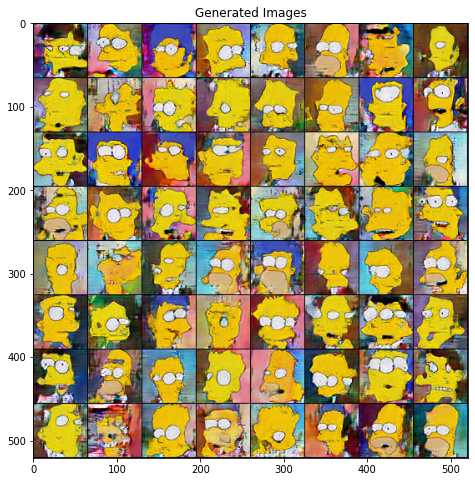

Epoch [641/2000], Step [32/32], Gen. Loss: 4.0530, Disc Loss: 0.0509
Epoch [642/2000], Step [32/32], Gen. Loss: 4.2961, Disc Loss: 0.0407
Epoch [643/2000], Step [32/32], Gen. Loss: 4.3867, Disc Loss: 0.0477
Epoch [644/2000], Step [32/32], Gen. Loss: 4.0903, Disc Loss: 0.0828
Epoch [645/2000], Step [32/32], Gen. Loss: 4.1316, Disc Loss: 0.0584
Epoch [646/2000], Step [32/32], Gen. Loss: 4.2088, Disc Loss: 0.0487
Epoch [647/2000], Step [32/32], Gen. Loss: 4.3058, Disc Loss: 0.0407
Epoch [648/2000], Step [32/32], Gen. Loss: 4.4094, Disc Loss: 0.0466
Epoch [649/2000], Step [32/32], Gen. Loss: 4.1969, Disc Loss: 0.0636
Epoch [650/2000], Step [32/32], Gen. Loss: 4.0677, Disc Loss: 0.0491
Epoch [651/2000], Step [32/32], Gen. Loss: 4.3601, Disc Loss: 0.0373
Epoch [652/2000], Step [32/32], Gen. Loss: 4.1862, Disc Loss: 0.0363
Epoch [653/2000], Step [32/32], Gen. Loss: 4.5114, Disc Loss: 0.0355
Epoch [654/2000], Step [32/32], Gen. Loss: 4.3339, Disc Loss: 0.0358
Epoch [655/2000], Step [32/32], Ge

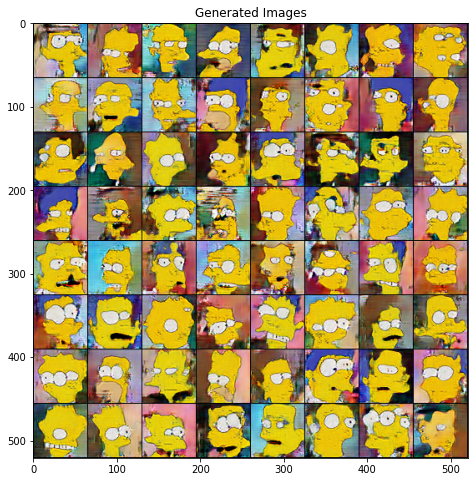

Epoch [661/2000], Step [32/32], Gen. Loss: 4.2656, Disc Loss: 0.0379
Epoch [662/2000], Step [32/32], Gen. Loss: 4.4978, Disc Loss: 0.0335
Epoch [663/2000], Step [32/32], Gen. Loss: 4.3495, Disc Loss: 0.0496
Epoch [664/2000], Step [32/32], Gen. Loss: 4.0954, Disc Loss: 0.1550
Epoch [665/2000], Step [32/32], Gen. Loss: 4.2356, Disc Loss: 0.0815
Epoch [666/2000], Step [32/32], Gen. Loss: 4.2366, Disc Loss: 0.0547
Epoch [667/2000], Step [32/32], Gen. Loss: 4.3448, Disc Loss: 0.0514
Epoch [668/2000], Step [32/32], Gen. Loss: 4.4134, Disc Loss: 0.0386
Epoch [669/2000], Step [32/32], Gen. Loss: 4.2859, Disc Loss: 0.0402
Epoch [670/2000], Step [32/32], Gen. Loss: 4.5768, Disc Loss: 0.0342
Epoch [671/2000], Step [32/32], Gen. Loss: 4.4719, Disc Loss: 0.0382
Epoch [672/2000], Step [32/32], Gen. Loss: 4.3046, Disc Loss: 0.0607
Epoch [673/2000], Step [32/32], Gen. Loss: 4.2921, Disc Loss: 0.0387
Epoch [674/2000], Step [32/32], Gen. Loss: 4.5880, Disc Loss: 0.0331
Epoch [675/2000], Step [32/32], Ge

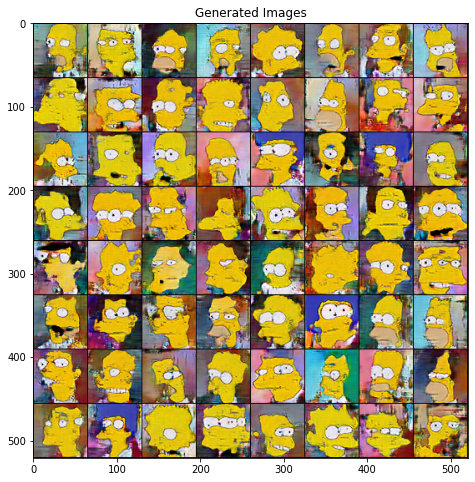

Epoch [681/2000], Step [32/32], Gen. Loss: 4.3283, Disc Loss: 0.0436
Epoch [682/2000], Step [32/32], Gen. Loss: 4.6462, Disc Loss: 0.0369
Epoch [683/2000], Step [32/32], Gen. Loss: 4.4536, Disc Loss: 0.0420
Epoch [684/2000], Step [32/32], Gen. Loss: 4.3079, Disc Loss: 0.0366
Epoch [685/2000], Step [32/32], Gen. Loss: 4.4881, Disc Loss: 0.0323
Epoch [686/2000], Step [32/32], Gen. Loss: 4.5320, Disc Loss: 0.0343
Epoch [687/2000], Step [32/32], Gen. Loss: 4.3879, Disc Loss: 0.0383
Epoch [688/2000], Step [32/32], Gen. Loss: 4.3066, Disc Loss: 0.0622
Epoch [689/2000], Step [32/32], Gen. Loss: 4.1939, Disc Loss: 0.0784
Epoch [690/2000], Step [32/32], Gen. Loss: 4.3833, Disc Loss: 0.0594
Epoch [691/2000], Step [32/32], Gen. Loss: 4.2193, Disc Loss: 0.0554
Epoch [692/2000], Step [32/32], Gen. Loss: 4.4799, Disc Loss: 0.0769
Epoch [693/2000], Step [32/32], Gen. Loss: 4.4231, Disc Loss: 0.0479
Epoch [694/2000], Step [32/32], Gen. Loss: 4.6965, Disc Loss: 0.0394
Epoch [695/2000], Step [32/32], Ge

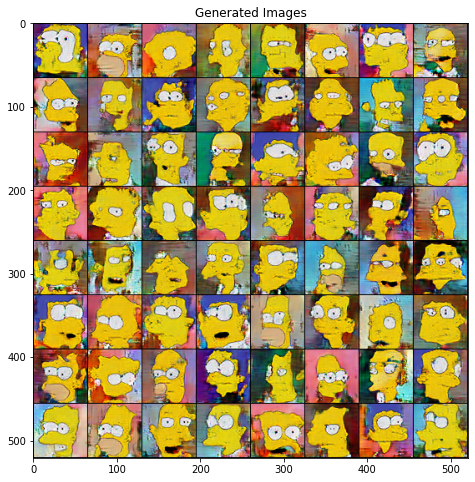

Epoch [701/2000], Step [32/32], Gen. Loss: 4.6314, Disc Loss: 0.0364
Epoch [702/2000], Step [32/32], Gen. Loss: 4.6547, Disc Loss: 0.0352
Epoch [703/2000], Step [32/32], Gen. Loss: 4.5298, Disc Loss: 0.0304
Epoch [704/2000], Step [32/32], Gen. Loss: 4.4644, Disc Loss: 0.0327
Epoch [705/2000], Step [32/32], Gen. Loss: 4.7699, Disc Loss: 0.0308
Epoch [706/2000], Step [32/32], Gen. Loss: 4.3803, Disc Loss: 0.0419
Epoch [707/2000], Step [32/32], Gen. Loss: 4.5470, Disc Loss: 0.0335
Epoch [708/2000], Step [32/32], Gen. Loss: 4.7356, Disc Loss: 0.0325
Epoch [709/2000], Step [32/32], Gen. Loss: 4.7149, Disc Loss: 0.0303
Epoch [710/2000], Step [32/32], Gen. Loss: 4.5368, Disc Loss: 0.0363
Epoch [711/2000], Step [32/32], Gen. Loss: 4.4864, Disc Loss: 0.0321
Epoch [712/2000], Step [32/32], Gen. Loss: 4.6687, Disc Loss: 0.0287
Epoch [713/2000], Step [32/32], Gen. Loss: 4.5617, Disc Loss: 0.0354
Epoch [714/2000], Step [32/32], Gen. Loss: 4.4392, Disc Loss: 0.0413
Epoch [715/2000], Step [32/32], Ge

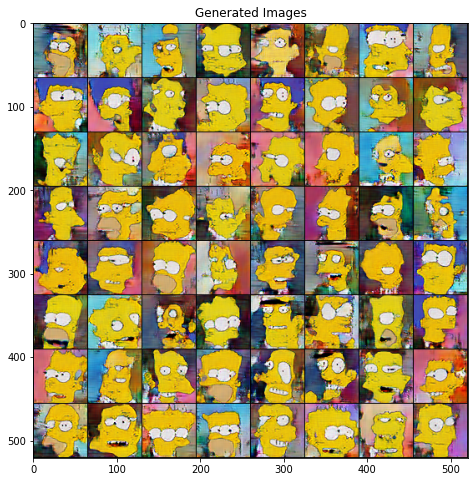

Epoch [721/2000], Step [32/32], Gen. Loss: 4.5560, Disc Loss: 0.0318
Epoch [722/2000], Step [32/32], Gen. Loss: 4.8287, Disc Loss: 0.0298
Epoch [723/2000], Step [32/32], Gen. Loss: 4.6563, Disc Loss: 0.0296
Epoch [724/2000], Step [32/32], Gen. Loss: 4.5485, Disc Loss: 0.0322
Epoch [725/2000], Step [32/32], Gen. Loss: 4.6544, Disc Loss: 0.0320
Epoch [726/2000], Step [32/32], Gen. Loss: 4.7360, Disc Loss: 0.0303
Epoch [727/2000], Step [32/32], Gen. Loss: 4.5576, Disc Loss: 0.0311
Epoch [728/2000], Step [32/32], Gen. Loss: 4.6222, Disc Loss: 0.0277
Epoch [729/2000], Step [32/32], Gen. Loss: 4.7780, Disc Loss: 0.0277
Epoch [730/2000], Step [32/32], Gen. Loss: 4.6075, Disc Loss: 0.0298
Epoch [731/2000], Step [32/32], Gen. Loss: 4.6944, Disc Loss: 0.0297
Epoch [732/2000], Step [32/32], Gen. Loss: 4.5831, Disc Loss: 0.0323
Epoch [733/2000], Step [32/32], Gen. Loss: 4.8469, Disc Loss: 0.0288
Epoch [734/2000], Step [32/32], Gen. Loss: 4.5799, Disc Loss: 0.0421
Epoch [735/2000], Step [32/32], Ge

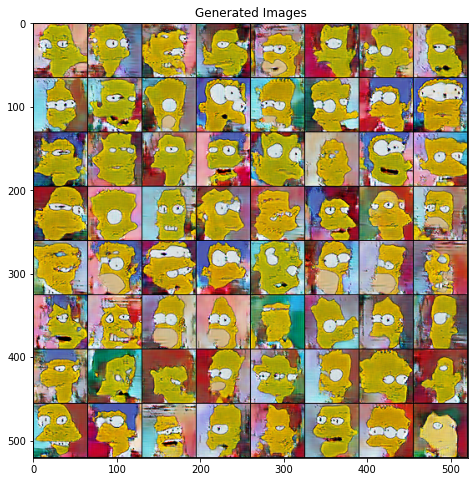

Epoch [741/2000], Step [32/32], Gen. Loss: 5.4518, Disc Loss: 0.0363
Epoch [742/2000], Step [32/32], Gen. Loss: 4.7183, Disc Loss: 0.0407
Epoch [743/2000], Step [32/32], Gen. Loss: 4.8401, Disc Loss: 0.0361
Epoch [744/2000], Step [32/32], Gen. Loss: 4.6741, Disc Loss: 0.0350
Epoch [745/2000], Step [32/32], Gen. Loss: 4.6902, Disc Loss: 0.0351
Epoch [746/2000], Step [32/32], Gen. Loss: 4.9247, Disc Loss: 0.0350
Epoch [747/2000], Step [32/32], Gen. Loss: 4.7845, Disc Loss: 0.0337
Epoch [748/2000], Step [32/32], Gen. Loss: 4.4695, Disc Loss: 0.0347
Epoch [749/2000], Step [32/32], Gen. Loss: 4.9046, Disc Loss: 0.0326
Epoch [750/2000], Step [32/32], Gen. Loss: 4.6372, Disc Loss: 0.0327
Epoch [751/2000], Step [32/32], Gen. Loss: 4.7935, Disc Loss: 0.0323
Epoch [752/2000], Step [32/32], Gen. Loss: 4.5376, Disc Loss: 0.0334
Epoch [753/2000], Step [32/32], Gen. Loss: 4.7659, Disc Loss: 0.0324
Epoch [754/2000], Step [32/32], Gen. Loss: 4.6503, Disc Loss: 0.0292
Epoch [755/2000], Step [32/32], Ge

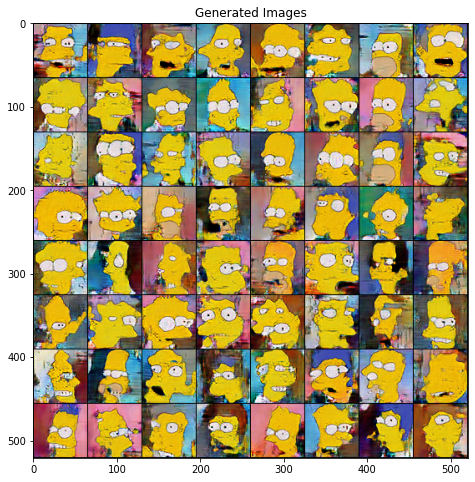

Epoch [761/2000], Step [32/32], Gen. Loss: 4.7727, Disc Loss: 0.0277
Epoch [762/2000], Step [32/32], Gen. Loss: 4.6893, Disc Loss: 0.0278
Epoch [763/2000], Step [32/32], Gen. Loss: 4.8483, Disc Loss: 0.0253
Epoch [764/2000], Step [32/32], Gen. Loss: 4.7204, Disc Loss: 0.0277
Epoch [765/2000], Step [32/32], Gen. Loss: 4.8469, Disc Loss: 0.0267
Epoch [766/2000], Step [32/32], Gen. Loss: 4.4647, Disc Loss: 0.0339
Epoch [767/2000], Step [32/32], Gen. Loss: 5.0588, Disc Loss: 0.0309
Epoch [768/2000], Step [32/32], Gen. Loss: 4.5813, Disc Loss: 0.0730
Epoch [769/2000], Step [32/32], Gen. Loss: 4.6785, Disc Loss: 0.0366
Epoch [770/2000], Step [32/32], Gen. Loss: 4.7988, Disc Loss: 0.0332
Epoch [771/2000], Step [32/32], Gen. Loss: 4.8500, Disc Loss: 0.0287
Epoch [772/2000], Step [32/32], Gen. Loss: 4.7835, Disc Loss: 0.0281
Epoch [773/2000], Step [32/32], Gen. Loss: 4.9684, Disc Loss: 0.0240
Epoch [774/2000], Step [32/32], Gen. Loss: 4.9155, Disc Loss: 0.0244
Epoch [775/2000], Step [32/32], Ge

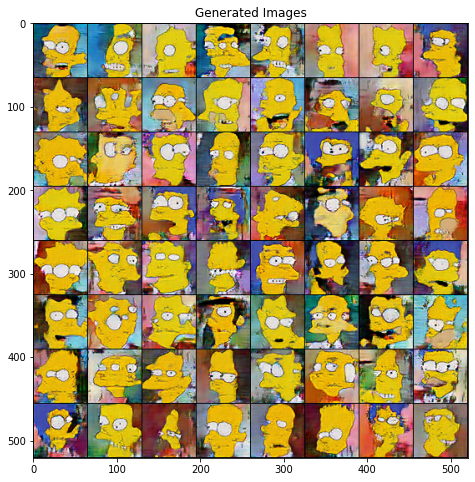

Epoch [781/2000], Step [32/32], Gen. Loss: 4.9256, Disc Loss: 0.0240
Epoch [782/2000], Step [32/32], Gen. Loss: 5.0054, Disc Loss: 0.0237
Epoch [783/2000], Step [32/32], Gen. Loss: 5.0664, Disc Loss: 0.0241
Epoch [784/2000], Step [32/32], Gen. Loss: 4.9253, Disc Loss: 0.0240
Epoch [785/2000], Step [32/32], Gen. Loss: 4.6332, Disc Loss: 0.0279
Epoch [786/2000], Step [32/32], Gen. Loss: 4.9694, Disc Loss: 0.0305
Epoch [787/2000], Step [32/32], Gen. Loss: 4.6897, Disc Loss: 0.0682
Epoch [788/2000], Step [32/32], Gen. Loss: 4.8166, Disc Loss: 0.0486
Epoch [789/2000], Step [32/32], Gen. Loss: 4.8039, Disc Loss: 0.0349
Epoch [790/2000], Step [32/32], Gen. Loss: 5.0285, Disc Loss: 0.0252
Epoch [791/2000], Step [32/32], Gen. Loss: 4.8769, Disc Loss: 0.0250
Epoch [792/2000], Step [32/32], Gen. Loss: 4.8169, Disc Loss: 0.0264
Epoch [793/2000], Step [32/32], Gen. Loss: 5.0571, Disc Loss: 0.0256
Epoch [794/2000], Step [32/32], Gen. Loss: 4.6380, Disc Loss: 0.0313
Epoch [795/2000], Step [32/32], Ge

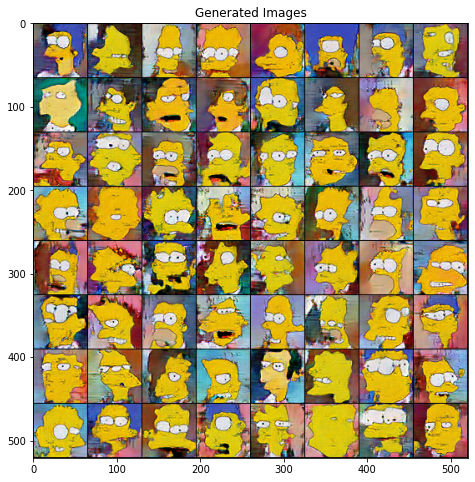

Epoch [801/2000], Step [32/32], Gen. Loss: 4.8503, Disc Loss: 0.0252
Epoch [802/2000], Step [32/32], Gen. Loss: 5.0455, Disc Loss: 0.0230
Epoch [803/2000], Step [32/32], Gen. Loss: 4.9516, Disc Loss: 0.0227
Epoch [804/2000], Step [32/32], Gen. Loss: 5.0700, Disc Loss: 0.0211
Epoch [805/2000], Step [32/32], Gen. Loss: 4.9974, Disc Loss: 0.0229
Epoch [806/2000], Step [32/32], Gen. Loss: 4.8358, Disc Loss: 0.0328
Epoch [807/2000], Step [32/32], Gen. Loss: 4.8563, Disc Loss: 0.0250
Epoch [808/2000], Step [32/32], Gen. Loss: 5.1902, Disc Loss: 0.0270
Epoch [809/2000], Step [32/32], Gen. Loss: 4.9217, Disc Loss: 0.0275
Epoch [810/2000], Step [32/32], Gen. Loss: 5.1617, Disc Loss: 0.0213
Epoch [811/2000], Step [32/32], Gen. Loss: 5.0966, Disc Loss: 0.0208
Epoch [812/2000], Step [32/32], Gen. Loss: 5.0033, Disc Loss: 0.0218
Epoch [813/2000], Step [32/32], Gen. Loss: 4.8379, Disc Loss: 0.0245
Epoch [814/2000], Step [32/32], Gen. Loss: 5.1145, Disc Loss: 0.0254
Epoch [815/2000], Step [32/32], Ge

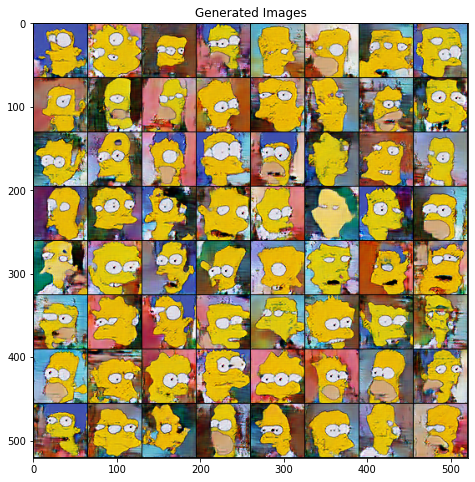

Epoch [821/2000], Step [32/32], Gen. Loss: 4.8608, Disc Loss: 0.0275
Epoch [822/2000], Step [32/32], Gen. Loss: 5.0249, Disc Loss: 0.0261
Epoch [823/2000], Step [32/32], Gen. Loss: 5.1041, Disc Loss: 0.0395
Epoch [824/2000], Step [32/32], Gen. Loss: 5.0092, Disc Loss: 0.0833
Epoch [825/2000], Step [32/32], Gen. Loss: 5.2501, Disc Loss: 0.0677
Epoch [826/2000], Step [32/32], Gen. Loss: 4.8397, Disc Loss: 0.0399
Epoch [827/2000], Step [32/32], Gen. Loss: 5.1966, Disc Loss: 0.0265
Epoch [828/2000], Step [32/32], Gen. Loss: 5.0670, Disc Loss: 0.0238
Epoch [829/2000], Step [32/32], Gen. Loss: 5.1828, Disc Loss: 0.0224
Epoch [830/2000], Step [32/32], Gen. Loss: 5.2160, Disc Loss: 0.0257
Epoch [831/2000], Step [32/32], Gen. Loss: 4.7393, Disc Loss: 0.0412
Epoch [832/2000], Step [32/32], Gen. Loss: 5.0250, Disc Loss: 0.0303
Epoch [833/2000], Step [32/32], Gen. Loss: 5.0138, Disc Loss: 0.0373
Epoch [834/2000], Step [32/32], Gen. Loss: 5.1792, Disc Loss: 0.0292
Epoch [835/2000], Step [32/32], Ge

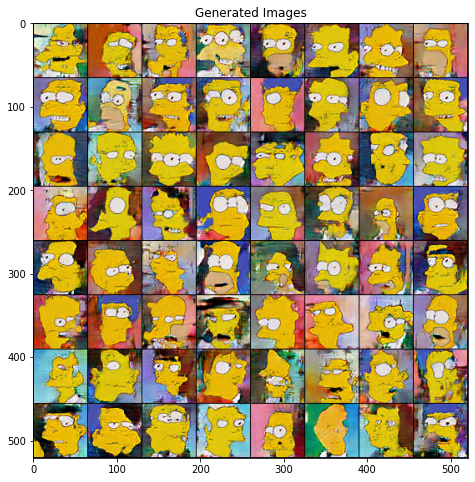

Epoch [841/2000], Step [32/32], Gen. Loss: 5.2515, Disc Loss: 0.0207
Epoch [842/2000], Step [32/32], Gen. Loss: 5.0838, Disc Loss: 0.0217
Epoch [843/2000], Step [32/32], Gen. Loss: 5.2328, Disc Loss: 0.0196
Epoch [844/2000], Step [32/32], Gen. Loss: 5.1994, Disc Loss: 0.0215
Epoch [845/2000], Step [32/32], Gen. Loss: 4.9258, Disc Loss: 0.0240
Epoch [846/2000], Step [32/32], Gen. Loss: 5.2089, Disc Loss: 0.0212
Epoch [847/2000], Step [32/32], Gen. Loss: 5.0837, Disc Loss: 0.0227
Epoch [848/2000], Step [32/32], Gen. Loss: 5.3553, Disc Loss: 0.0206
Epoch [849/2000], Step [32/32], Gen. Loss: 5.1016, Disc Loss: 0.0261
Epoch [850/2000], Step [32/32], Gen. Loss: 5.0995, Disc Loss: 0.0220
Epoch [851/2000], Step [32/32], Gen. Loss: 5.1884, Disc Loss: 0.0247
Epoch [852/2000], Step [32/32], Gen. Loss: 4.8500, Disc Loss: 0.0399
Epoch [853/2000], Step [32/32], Gen. Loss: 5.0927, Disc Loss: 0.0224
Epoch [854/2000], Step [32/32], Gen. Loss: 5.2115, Disc Loss: 0.0199
Epoch [855/2000], Step [32/32], Ge

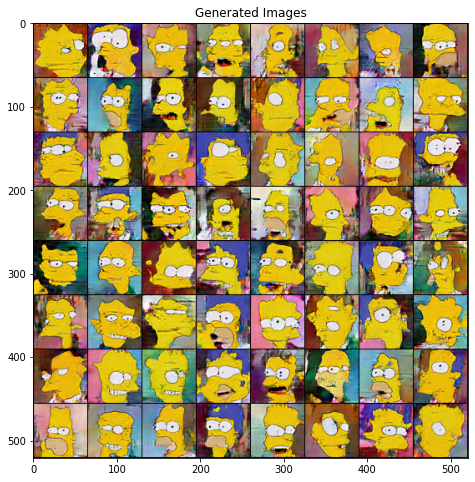

Epoch [861/2000], Step [32/32], Gen. Loss: 5.4049, Disc Loss: 0.0212
Epoch [862/2000], Step [32/32], Gen. Loss: 5.3112, Disc Loss: 0.0204
Epoch [863/2000], Step [32/32], Gen. Loss: 5.1891, Disc Loss: 0.0235
Epoch [864/2000], Step [32/32], Gen. Loss: 5.3117, Disc Loss: 0.0205
Epoch [865/2000], Step [32/32], Gen. Loss: 5.2854, Disc Loss: 0.0186
Epoch [866/2000], Step [32/32], Gen. Loss: 5.2389, Disc Loss: 0.0232
Epoch [867/2000], Step [32/32], Gen. Loss: 5.3766, Disc Loss: 0.0199
Epoch [868/2000], Step [32/32], Gen. Loss: 5.2664, Disc Loss: 0.0185
Epoch [869/2000], Step [32/32], Gen. Loss: 5.1765, Disc Loss: 0.0202
Epoch [870/2000], Step [32/32], Gen. Loss: 5.3272, Disc Loss: 0.0190
Epoch [871/2000], Step [32/32], Gen. Loss: 5.1696, Disc Loss: 0.0244
Epoch [872/2000], Step [32/32], Gen. Loss: 5.3070, Disc Loss: 0.0210
Epoch [873/2000], Step [32/32], Gen. Loss: 5.3506, Disc Loss: 0.0218
Epoch [874/2000], Step [32/32], Gen. Loss: 5.2578, Disc Loss: 0.0227
Epoch [875/2000], Step [32/32], Ge

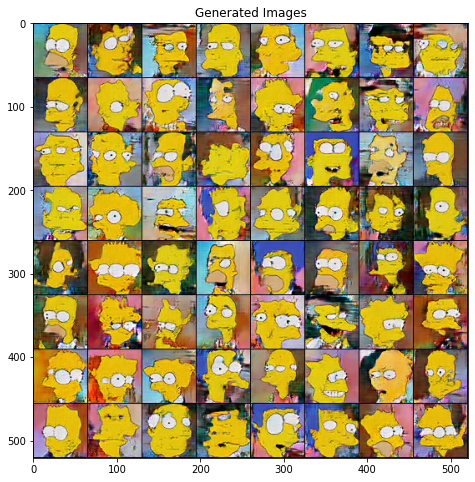

Epoch [881/2000], Step [32/32], Gen. Loss: 5.4394, Disc Loss: 0.0201
Epoch [882/2000], Step [32/32], Gen. Loss: 5.1708, Disc Loss: 0.0259
Epoch [883/2000], Step [32/32], Gen. Loss: 5.4822, Disc Loss: 0.0187
Epoch [884/2000], Step [32/32], Gen. Loss: 5.4816, Disc Loss: 0.0174
Epoch [885/2000], Step [32/32], Gen. Loss: 5.2478, Disc Loss: 0.0177
Epoch [886/2000], Step [32/32], Gen. Loss: 5.5211, Disc Loss: 0.0158
Epoch [887/2000], Step [32/32], Gen. Loss: 5.3915, Disc Loss: 0.0164
Epoch [888/2000], Step [32/32], Gen. Loss: 5.4143, Disc Loss: 0.0183
Epoch [889/2000], Step [32/32], Gen. Loss: 5.2679, Disc Loss: 0.0189
Epoch [890/2000], Step [32/32], Gen. Loss: 5.4380, Disc Loss: 0.0173
Epoch [891/2000], Step [32/32], Gen. Loss: 5.4719, Disc Loss: 0.0164
Epoch [892/2000], Step [32/32], Gen. Loss: 5.4621, Disc Loss: 0.0164
Epoch [893/2000], Step [32/32], Gen. Loss: 5.4262, Disc Loss: 0.0214
Epoch [894/2000], Step [32/32], Gen. Loss: 5.3386, Disc Loss: 0.0270
Epoch [895/2000], Step [32/32], Ge

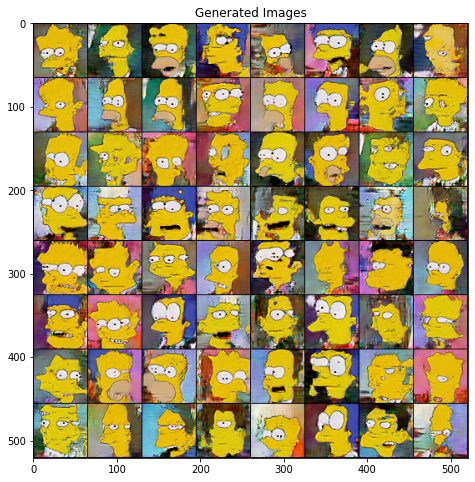

Epoch [901/2000], Step [32/32], Gen. Loss: 5.4381, Disc Loss: 0.0180
Epoch [902/2000], Step [32/32], Gen. Loss: 5.3336, Disc Loss: 0.0246
Epoch [903/2000], Step [32/32], Gen. Loss: 5.0942, Disc Loss: 0.0413
Epoch [904/2000], Step [32/32], Gen. Loss: 4.9916, Disc Loss: 0.0797
Epoch [905/2000], Step [32/32], Gen. Loss: 5.3301, Disc Loss: 0.0384
Epoch [906/2000], Step [32/32], Gen. Loss: 5.1192, Disc Loss: 0.0238
Epoch [907/2000], Step [32/32], Gen. Loss: 5.1157, Disc Loss: 0.0248
Epoch [908/2000], Step [32/32], Gen. Loss: 5.3965, Disc Loss: 0.0193
Epoch [909/2000], Step [32/32], Gen. Loss: 5.3118, Disc Loss: 0.0185
Epoch [910/2000], Step [32/32], Gen. Loss: 5.4735, Disc Loss: 0.0157
Epoch [911/2000], Step [32/32], Gen. Loss: 5.5310, Disc Loss: 0.0180
Epoch [912/2000], Step [32/32], Gen. Loss: 5.2373, Disc Loss: 0.0337
Epoch [913/2000], Step [32/32], Gen. Loss: 5.3406, Disc Loss: 0.0234
Epoch [914/2000], Step [32/32], Gen. Loss: 5.5534, Disc Loss: 0.0197
Epoch [915/2000], Step [32/32], Ge

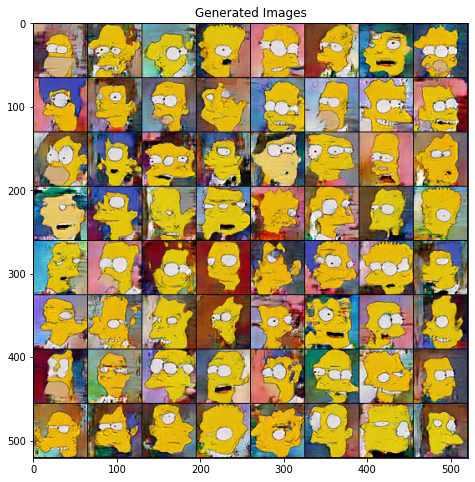

Epoch [921/2000], Step [32/32], Gen. Loss: 5.5395, Disc Loss: 0.0147
Epoch [922/2000], Step [32/32], Gen. Loss: 5.5884, Disc Loss: 0.0135
Epoch [923/2000], Step [32/32], Gen. Loss: 5.5907, Disc Loss: 0.0135
Epoch [924/2000], Step [32/32], Gen. Loss: 5.5570, Disc Loss: 0.0142
Epoch [925/2000], Step [32/32], Gen. Loss: 5.6717, Disc Loss: 0.0134
Epoch [926/2000], Step [32/32], Gen. Loss: 5.3728, Disc Loss: 0.0198
Epoch [927/2000], Step [32/32], Gen. Loss: 5.7404, Disc Loss: 0.0154
Epoch [928/2000], Step [32/32], Gen. Loss: 5.6196, Disc Loss: 0.0158
Epoch [929/2000], Step [32/32], Gen. Loss: 5.5784, Disc Loss: 0.0142
Epoch [930/2000], Step [32/32], Gen. Loss: 5.5497, Disc Loss: 0.0153
Epoch [931/2000], Step [32/32], Gen. Loss: 5.7040, Disc Loss: 0.0134
Epoch [932/2000], Step [32/32], Gen. Loss: 5.4813, Disc Loss: 0.0141
Epoch [933/2000], Step [32/32], Gen. Loss: 5.6113, Disc Loss: 0.0141
Epoch [934/2000], Step [32/32], Gen. Loss: 5.5453, Disc Loss: 0.0139
Epoch [935/2000], Step [32/32], Ge

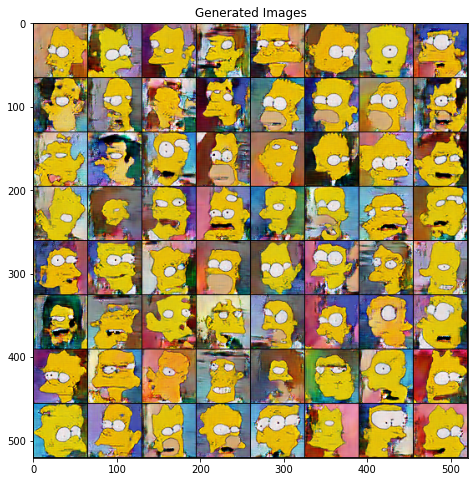

Epoch [941/2000], Step [32/32], Gen. Loss: 5.5271, Disc Loss: 0.0154
Epoch [942/2000], Step [32/32], Gen. Loss: 5.6349, Disc Loss: 0.0140
Epoch [943/2000], Step [32/32], Gen. Loss: 5.5853, Disc Loss: 0.0192
Epoch [944/2000], Step [32/32], Gen. Loss: 5.4661, Disc Loss: 0.0184
Epoch [945/2000], Step [32/32], Gen. Loss: 5.9322, Disc Loss: 0.0219
Epoch [946/2000], Step [32/32], Gen. Loss: 4.9736, Disc Loss: 0.1373
Epoch [947/2000], Step [32/32], Gen. Loss: 5.7307, Disc Loss: 0.0349
Epoch [948/2000], Step [32/32], Gen. Loss: 5.4113, Disc Loss: 0.0245
Epoch [949/2000], Step [32/32], Gen. Loss: 5.4105, Disc Loss: 0.0181
Epoch [950/2000], Step [32/32], Gen. Loss: 5.5259, Disc Loss: 0.0170
Epoch [951/2000], Step [32/32], Gen. Loss: 5.5167, Disc Loss: 0.0160
Epoch [952/2000], Step [32/32], Gen. Loss: 5.7164, Disc Loss: 0.0164
Epoch [953/2000], Step [32/32], Gen. Loss: 5.6317, Disc Loss: 0.0134
Epoch [954/2000], Step [32/32], Gen. Loss: 5.6568, Disc Loss: 0.0153
Epoch [955/2000], Step [32/32], Ge

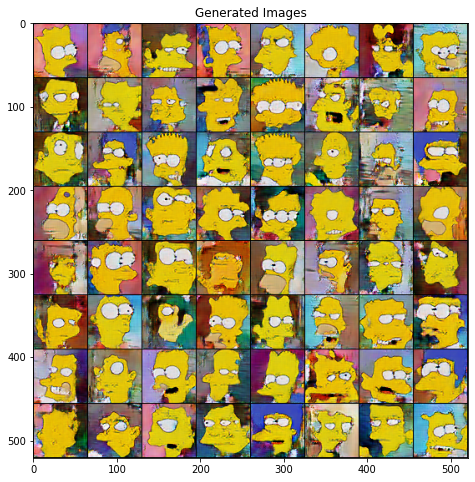

Epoch [961/2000], Step [32/32], Gen. Loss: 5.5692, Disc Loss: 0.0132
Epoch [962/2000], Step [32/32], Gen. Loss: 5.7841, Disc Loss: 0.0120
Epoch [963/2000], Step [32/32], Gen. Loss: 5.9424, Disc Loss: 0.0127
Epoch [964/2000], Step [32/32], Gen. Loss: 5.5745, Disc Loss: 0.0173
Epoch [965/2000], Step [32/32], Gen. Loss: 5.5650, Disc Loss: 0.0235
Epoch [966/2000], Step [32/32], Gen. Loss: 5.8129, Disc Loss: 0.0169
Epoch [967/2000], Step [32/32], Gen. Loss: 5.7345, Disc Loss: 0.0164
Epoch [968/2000], Step [32/32], Gen. Loss: 5.6551, Disc Loss: 0.0148
Epoch [969/2000], Step [32/32], Gen. Loss: 5.9151, Disc Loss: 0.0129
Epoch [970/2000], Step [32/32], Gen. Loss: 5.6969, Disc Loss: 0.0153
Epoch [971/2000], Step [32/32], Gen. Loss: 5.8233, Disc Loss: 0.0116
Epoch [972/2000], Step [32/32], Gen. Loss: 5.9916, Disc Loss: 0.0139
Epoch [973/2000], Step [32/32], Gen. Loss: 5.5371, Disc Loss: 0.0264
Epoch [974/2000], Step [32/32], Gen. Loss: 5.3615, Disc Loss: 0.0290
Epoch [975/2000], Step [32/32], Ge

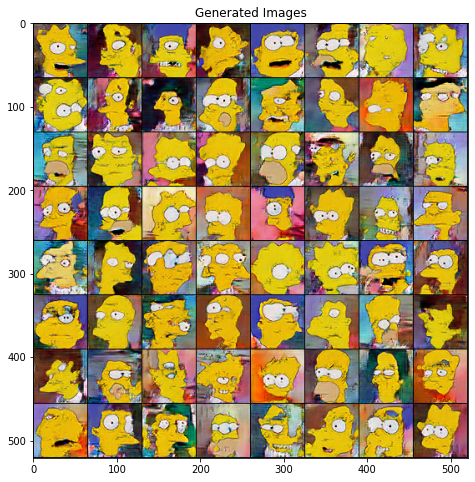

Epoch [981/2000], Step [32/32], Gen. Loss: 5.8273, Disc Loss: 0.0262
Epoch [982/2000], Step [32/32], Gen. Loss: 5.3259, Disc Loss: 0.0305
Epoch [983/2000], Step [32/32], Gen. Loss: 5.3588, Disc Loss: 0.0287
Epoch [984/2000], Step [32/32], Gen. Loss: 6.4430, Disc Loss: 0.0312
Epoch [985/2000], Step [32/32], Gen. Loss: 5.9032, Disc Loss: 0.0330
Epoch [986/2000], Step [32/32], Gen. Loss: 5.5790, Disc Loss: 0.0791
Epoch [987/2000], Step [32/32], Gen. Loss: 5.4205, Disc Loss: 0.0389
Epoch [988/2000], Step [32/32], Gen. Loss: 5.4714, Disc Loss: 0.0238
Epoch [989/2000], Step [32/32], Gen. Loss: 5.8462, Disc Loss: 0.0158
Epoch [990/2000], Step [32/32], Gen. Loss: 5.6092, Disc Loss: 0.0162
Epoch [991/2000], Step [32/32], Gen. Loss: 5.9927, Disc Loss: 0.0182
Epoch [992/2000], Step [32/32], Gen. Loss: 5.5127, Disc Loss: 0.0449
Epoch [993/2000], Step [32/32], Gen. Loss: 5.4065, Disc Loss: 0.0389
Epoch [994/2000], Step [32/32], Gen. Loss: 5.6859, Disc Loss: 0.0208
Epoch [995/2000], Step [32/32], Ge

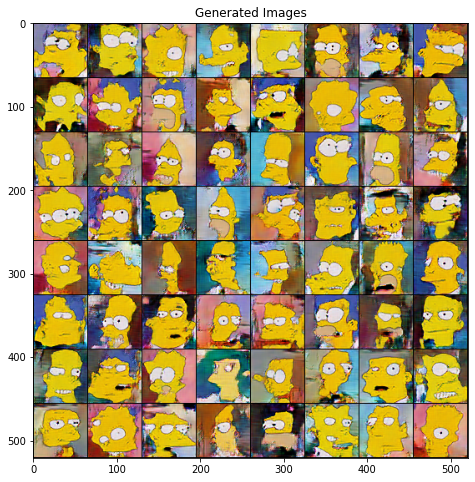

Epoch [1001/2000], Step [32/32], Gen. Loss: 5.8010, Disc Loss: 0.0123
Epoch [1002/2000], Step [32/32], Gen. Loss: 5.8492, Disc Loss: 0.0120
Epoch [1003/2000], Step [32/32], Gen. Loss: 5.8683, Disc Loss: 0.0112
Epoch [1004/2000], Step [32/32], Gen. Loss: 5.8549, Disc Loss: 0.0107
Epoch [1005/2000], Step [32/32], Gen. Loss: 5.7616, Disc Loss: 0.0117
Epoch [1006/2000], Step [32/32], Gen. Loss: 5.7440, Disc Loss: 0.0126
Epoch [1007/2000], Step [32/32], Gen. Loss: 6.2061, Disc Loss: 0.0173
Epoch [1008/2000], Step [32/32], Gen. Loss: 5.5646, Disc Loss: 0.0571
Epoch [1009/2000], Step [32/32], Gen. Loss: 5.3545, Disc Loss: 0.0260
Epoch [1010/2000], Step [32/32], Gen. Loss: 5.8105, Disc Loss: 0.0166
Epoch [1011/2000], Step [32/32], Gen. Loss: 5.7372, Disc Loss: 0.0148
Epoch [1012/2000], Step [32/32], Gen. Loss: 5.9956, Disc Loss: 0.0138
Epoch [1013/2000], Step [32/32], Gen. Loss: 5.8784, Disc Loss: 0.0132
Epoch [1014/2000], Step [32/32], Gen. Loss: 5.7725, Disc Loss: 0.0176
Epoch [1015/2000], S

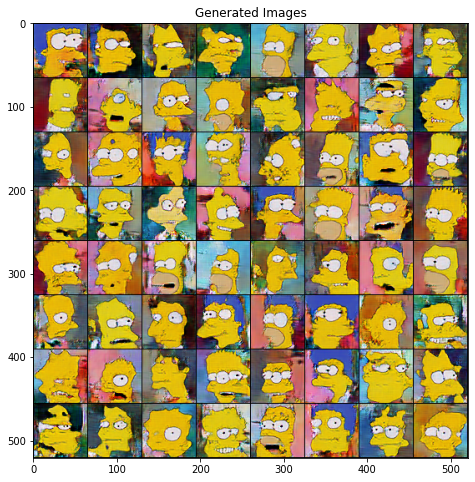

Epoch [1021/2000], Step [32/32], Gen. Loss: 5.5420, Disc Loss: 0.0291
Epoch [1022/2000], Step [32/32], Gen. Loss: 5.7994, Disc Loss: 0.0222
Epoch [1023/2000], Step [32/32], Gen. Loss: 5.9555, Disc Loss: 0.0137
Epoch [1024/2000], Step [32/32], Gen. Loss: 6.0619, Disc Loss: 0.0168
Epoch [1025/2000], Step [32/32], Gen. Loss: 5.4425, Disc Loss: 0.0272
Epoch [1026/2000], Step [32/32], Gen. Loss: 6.2326, Disc Loss: 0.0148
Epoch [1027/2000], Step [32/32], Gen. Loss: 5.7891, Disc Loss: 0.0127
Epoch [1028/2000], Step [32/32], Gen. Loss: 6.0657, Disc Loss: 0.0114
Epoch [1029/2000], Step [32/32], Gen. Loss: 6.0037, Disc Loss: 0.0122
Epoch [1030/2000], Step [32/32], Gen. Loss: 5.9805, Disc Loss: 0.0103
Epoch [1031/2000], Step [32/32], Gen. Loss: 6.1292, Disc Loss: 0.0093
Epoch [1032/2000], Step [32/32], Gen. Loss: 6.0763, Disc Loss: 0.0101
Epoch [1033/2000], Step [32/32], Gen. Loss: 5.9954, Disc Loss: 0.0125
Epoch [1034/2000], Step [32/32], Gen. Loss: 6.1127, Disc Loss: 0.0144
Epoch [1035/2000], S

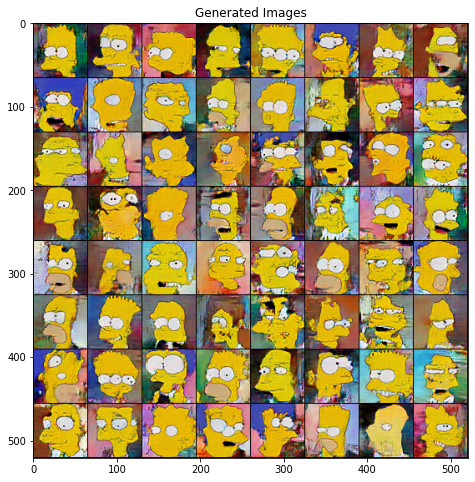

Epoch [1041/2000], Step [32/32], Gen. Loss: 6.0255, Disc Loss: 0.0103
Epoch [1042/2000], Step [32/32], Gen. Loss: 5.9440, Disc Loss: 0.0103
Epoch [1043/2000], Step [32/32], Gen. Loss: 6.1492, Disc Loss: 0.0119
Epoch [1044/2000], Step [32/32], Gen. Loss: 6.1303, Disc Loss: 0.0105
Epoch [1045/2000], Step [32/32], Gen. Loss: 5.8644, Disc Loss: 0.0124
Epoch [1046/2000], Step [32/32], Gen. Loss: 5.9988, Disc Loss: 0.0113
Epoch [1047/2000], Step [32/32], Gen. Loss: 5.8937, Disc Loss: 0.0094
Epoch [1048/2000], Step [32/32], Gen. Loss: 6.0317, Disc Loss: 0.0126
Epoch [1049/2000], Step [32/32], Gen. Loss: 5.6235, Disc Loss: 0.0295
Epoch [1050/2000], Step [32/32], Gen. Loss: 6.2651, Disc Loss: 0.0149
Epoch [1051/2000], Step [32/32], Gen. Loss: 6.2766, Disc Loss: 0.0125
Epoch [1052/2000], Step [32/32], Gen. Loss: 6.0297, Disc Loss: 0.0136
Epoch [1053/2000], Step [32/32], Gen. Loss: 6.2420, Disc Loss: 0.0100
Epoch [1054/2000], Step [32/32], Gen. Loss: 6.1096, Disc Loss: 0.0101
Epoch [1055/2000], S

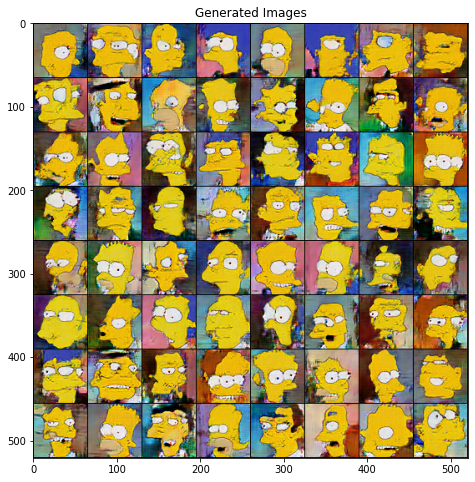

Epoch [1061/2000], Step [32/32], Gen. Loss: 5.6057, Disc Loss: 0.0243
Epoch [1062/2000], Step [32/32], Gen. Loss: 5.6312, Disc Loss: 0.0169
Epoch [1063/2000], Step [32/32], Gen. Loss: 6.0834, Disc Loss: 0.0143
Epoch [1064/2000], Step [32/32], Gen. Loss: 5.9622, Disc Loss: 0.0130
Epoch [1065/2000], Step [32/32], Gen. Loss: 6.0715, Disc Loss: 0.0111
Epoch [1066/2000], Step [32/32], Gen. Loss: 6.0330, Disc Loss: 0.0117
Epoch [1067/2000], Step [32/32], Gen. Loss: 5.9890, Disc Loss: 0.0112
Epoch [1068/2000], Step [32/32], Gen. Loss: 5.8870, Disc Loss: 0.0120
Epoch [1069/2000], Step [32/32], Gen. Loss: 6.1396, Disc Loss: 0.0101
Epoch [1070/2000], Step [32/32], Gen. Loss: 6.2732, Disc Loss: 0.0104
Epoch [1071/2000], Step [32/32], Gen. Loss: 5.9692, Disc Loss: 0.0123
Epoch [1072/2000], Step [32/32], Gen. Loss: 5.7080, Disc Loss: 0.0149
Epoch [1073/2000], Step [32/32], Gen. Loss: 6.1974, Disc Loss: 0.0117
Epoch [1074/2000], Step [32/32], Gen. Loss: 6.0531, Disc Loss: 0.0136
Epoch [1075/2000], S

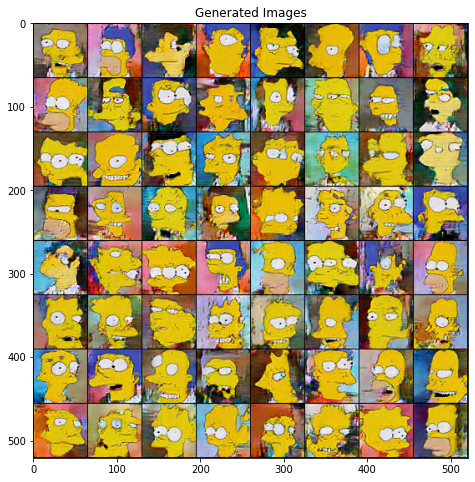

Epoch [1081/2000], Step [32/32], Gen. Loss: 6.0222, Disc Loss: 0.0133
Epoch [1082/2000], Step [32/32], Gen. Loss: 5.9848, Disc Loss: 0.0127
Epoch [1083/2000], Step [32/32], Gen. Loss: 6.2041, Disc Loss: 0.0106
Epoch [1084/2000], Step [32/32], Gen. Loss: 5.9665, Disc Loss: 0.0133
Epoch [1085/2000], Step [32/32], Gen. Loss: 6.2435, Disc Loss: 0.0114
Epoch [1086/2000], Step [32/32], Gen. Loss: 6.0485, Disc Loss: 0.0101
Epoch [1087/2000], Step [32/32], Gen. Loss: 6.0290, Disc Loss: 0.0169
Epoch [1088/2000], Step [32/32], Gen. Loss: 5.6744, Disc Loss: 0.0474
Epoch [1089/2000], Step [32/32], Gen. Loss: 5.7639, Disc Loss: 0.0356
Epoch [1090/2000], Step [32/32], Gen. Loss: 5.8532, Disc Loss: 0.0318
Epoch [1091/2000], Step [32/32], Gen. Loss: 6.0232, Disc Loss: 0.0191
Epoch [1092/2000], Step [32/32], Gen. Loss: 5.9147, Disc Loss: 0.0160
Epoch [1093/2000], Step [32/32], Gen. Loss: 5.9190, Disc Loss: 0.0185
Epoch [1094/2000], Step [32/32], Gen. Loss: 6.3095, Disc Loss: 0.0132
Epoch [1095/2000], S

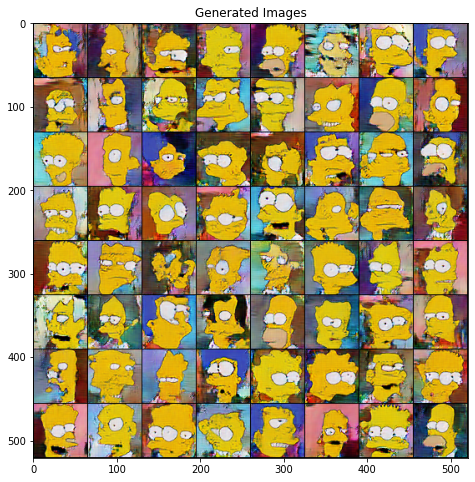

Epoch [1101/2000], Step [32/32], Gen. Loss: 6.0832, Disc Loss: 0.0094
Epoch [1102/2000], Step [32/32], Gen. Loss: 6.1487, Disc Loss: 0.0109
Epoch [1103/2000], Step [32/32], Gen. Loss: 6.0697, Disc Loss: 0.0091
Epoch [1104/2000], Step [32/32], Gen. Loss: 6.0823, Disc Loss: 0.0091
Epoch [1105/2000], Step [32/32], Gen. Loss: 6.3330, Disc Loss: 0.0089
Epoch [1106/2000], Step [32/32], Gen. Loss: 6.2206, Disc Loss: 0.0086
Epoch [1107/2000], Step [32/32], Gen. Loss: 6.2093, Disc Loss: 0.0090
Epoch [1108/2000], Step [32/32], Gen. Loss: 6.2506, Disc Loss: 0.0083
Epoch [1109/2000], Step [32/32], Gen. Loss: 6.1952, Disc Loss: 0.0087
Epoch [1110/2000], Step [32/32], Gen. Loss: 6.2166, Disc Loss: 0.0089
Epoch [1111/2000], Step [32/32], Gen. Loss: 6.1809, Disc Loss: 0.0106
Epoch [1112/2000], Step [32/32], Gen. Loss: 6.1466, Disc Loss: 0.0112
Epoch [1113/2000], Step [32/32], Gen. Loss: 6.2032, Disc Loss: 0.0099
Epoch [1114/2000], Step [32/32], Gen. Loss: 6.1300, Disc Loss: 0.0096
Epoch [1115/2000], S

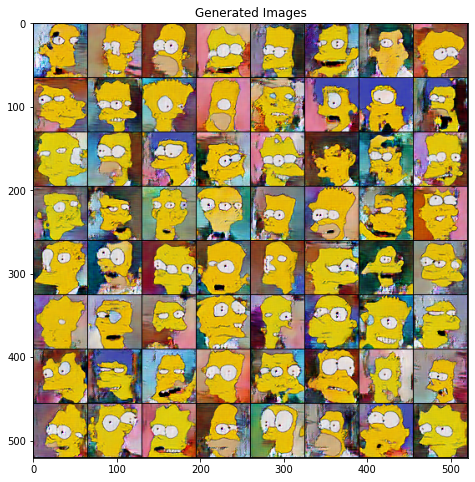

Epoch [1121/2000], Step [32/32], Gen. Loss: 6.3658, Disc Loss: 0.0095
Epoch [1122/2000], Step [32/32], Gen. Loss: 6.2728, Disc Loss: 0.0092
Epoch [1123/2000], Step [32/32], Gen. Loss: 5.9328, Disc Loss: 0.0160
Epoch [1124/2000], Step [32/32], Gen. Loss: 6.3951, Disc Loss: 0.0114
Epoch [1125/2000], Step [32/32], Gen. Loss: 6.1487, Disc Loss: 0.0108
Epoch [1126/2000], Step [32/32], Gen. Loss: 6.2841, Disc Loss: 0.0093
Epoch [1127/2000], Step [32/32], Gen. Loss: 6.0604, Disc Loss: 0.0105
Epoch [1128/2000], Step [32/32], Gen. Loss: 6.4043, Disc Loss: 0.0095
Epoch [1129/2000], Step [32/32], Gen. Loss: 6.3062, Disc Loss: 0.0092
Epoch [1130/2000], Step [32/32], Gen. Loss: 6.4126, Disc Loss: 0.0089
Epoch [1131/2000], Step [32/32], Gen. Loss: 6.4127, Disc Loss: 0.0080
Epoch [1132/2000], Step [32/32], Gen. Loss: 6.1324, Disc Loss: 0.0097
Epoch [1133/2000], Step [32/32], Gen. Loss: 6.3306, Disc Loss: 0.0084
Epoch [1134/2000], Step [32/32], Gen. Loss: 6.2324, Disc Loss: 0.0084
Epoch [1135/2000], S

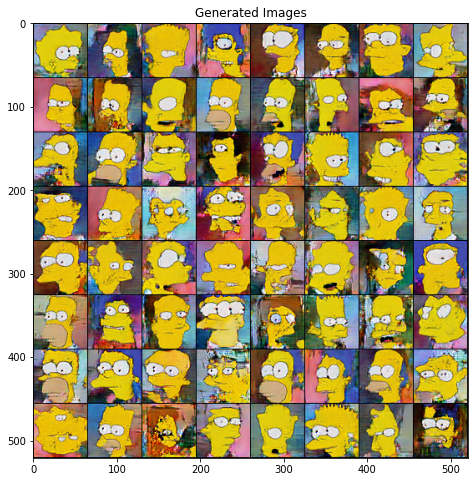

Epoch [1141/2000], Step [32/32], Gen. Loss: 6.2031, Disc Loss: 0.0153
Epoch [1142/2000], Step [32/32], Gen. Loss: 6.1233, Disc Loss: 0.0115
Epoch [1143/2000], Step [32/32], Gen. Loss: 6.1374, Disc Loss: 0.0122
Epoch [1144/2000], Step [32/32], Gen. Loss: 5.9343, Disc Loss: 0.0235
Epoch [1145/2000], Step [32/32], Gen. Loss: 5.9454, Disc Loss: 0.0231
Epoch [1146/2000], Step [32/32], Gen. Loss: 6.0852, Disc Loss: 0.0297
Epoch [1147/2000], Step [32/32], Gen. Loss: 5.9646, Disc Loss: 0.0142
Epoch [1148/2000], Step [32/32], Gen. Loss: 6.4228, Disc Loss: 0.0118
Epoch [1149/2000], Step [32/32], Gen. Loss: 6.2563, Disc Loss: 0.0092
Epoch [1150/2000], Step [32/32], Gen. Loss: 6.2314, Disc Loss: 0.0102
Epoch [1151/2000], Step [32/32], Gen. Loss: 6.4394, Disc Loss: 0.0102
Epoch [1152/2000], Step [32/32], Gen. Loss: 6.2683, Disc Loss: 0.0266
Epoch [1153/2000], Step [32/32], Gen. Loss: 6.1513, Disc Loss: 0.0459
Epoch [1154/2000], Step [32/32], Gen. Loss: 5.9763, Disc Loss: 0.1926
Epoch [1155/2000], S

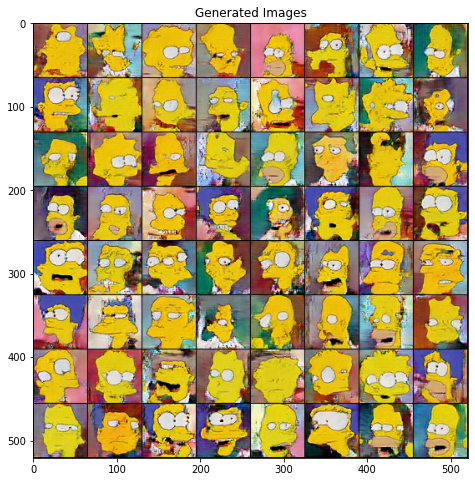

Epoch [1161/2000], Step [32/32], Gen. Loss: 6.1744, Disc Loss: 0.0160
Epoch [1162/2000], Step [32/32], Gen. Loss: 5.7226, Disc Loss: 0.0353
Epoch [1163/2000], Step [32/32], Gen. Loss: 6.3428, Disc Loss: 0.0145
Epoch [1164/2000], Step [32/32], Gen. Loss: 6.1416, Disc Loss: 0.0126
Epoch [1165/2000], Step [32/32], Gen. Loss: 6.2054, Disc Loss: 0.0105
Epoch [1166/2000], Step [32/32], Gen. Loss: 6.2047, Disc Loss: 0.0112
Epoch [1167/2000], Step [32/32], Gen. Loss: 6.4515, Disc Loss: 0.0091
Epoch [1168/2000], Step [32/32], Gen. Loss: 6.2559, Disc Loss: 0.0082
Epoch [1169/2000], Step [32/32], Gen. Loss: 6.4230, Disc Loss: 0.0084
Epoch [1170/2000], Step [32/32], Gen. Loss: 6.4191, Disc Loss: 0.0082
Epoch [1171/2000], Step [32/32], Gen. Loss: 6.2664, Disc Loss: 0.0103
Epoch [1172/2000], Step [32/32], Gen. Loss: 5.6992, Disc Loss: 0.0228
Epoch [1173/2000], Step [32/32], Gen. Loss: 6.5335, Disc Loss: 0.0103
Epoch [1174/2000], Step [32/32], Gen. Loss: 6.3126, Disc Loss: 0.0101
Epoch [1175/2000], S

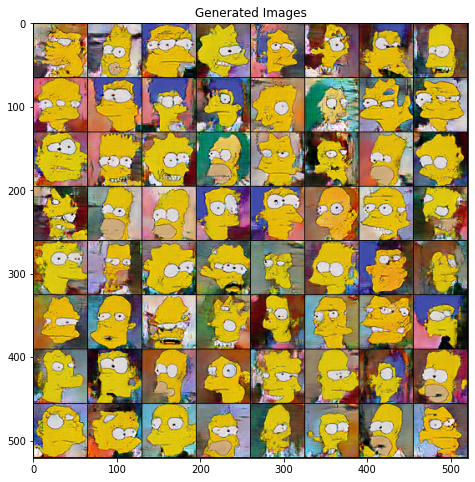

Epoch [1181/2000], Step [32/32], Gen. Loss: 6.3195, Disc Loss: 0.0086
Epoch [1182/2000], Step [32/32], Gen. Loss: 6.1972, Disc Loss: 0.0082
Epoch [1183/2000], Step [32/32], Gen. Loss: 6.5452, Disc Loss: 0.0078
Epoch [1184/2000], Step [32/32], Gen. Loss: 6.5188, Disc Loss: 0.0093
Epoch [1185/2000], Step [32/32], Gen. Loss: 6.0913, Disc Loss: 0.0104
Epoch [1186/2000], Step [32/32], Gen. Loss: 6.2999, Disc Loss: 0.0105
Epoch [1187/2000], Step [32/32], Gen. Loss: 6.5699, Disc Loss: 0.0107
Epoch [1188/2000], Step [32/32], Gen. Loss: 6.3783, Disc Loss: 0.0084
Epoch [1189/2000], Step [32/32], Gen. Loss: 6.1813, Disc Loss: 0.0077
Epoch [1190/2000], Step [32/32], Gen. Loss: 6.3476, Disc Loss: 0.0067
Epoch [1191/2000], Step [32/32], Gen. Loss: 6.4650, Disc Loss: 0.0071
Epoch [1192/2000], Step [32/32], Gen. Loss: 6.5069, Disc Loss: 0.0070
Epoch [1193/2000], Step [32/32], Gen. Loss: 6.2619, Disc Loss: 0.0079
Epoch [1194/2000], Step [32/32], Gen. Loss: 6.3473, Disc Loss: 0.0078
Epoch [1195/2000], S

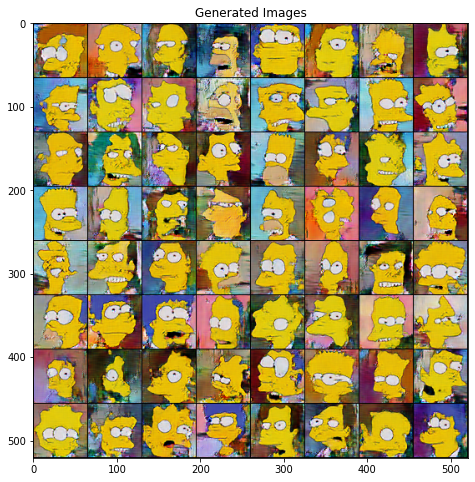

Epoch [1201/2000], Step [32/32], Gen. Loss: 6.0498, Disc Loss: 0.0155
Epoch [1202/2000], Step [32/32], Gen. Loss: 6.2921, Disc Loss: 0.0094
Epoch [1203/2000], Step [32/32], Gen. Loss: 6.5208, Disc Loss: 0.0084
Epoch [1204/2000], Step [32/32], Gen. Loss: 6.5637, Disc Loss: 0.0082
Epoch [1205/2000], Step [32/32], Gen. Loss: 6.3761, Disc Loss: 0.0089
Epoch [1206/2000], Step [32/32], Gen. Loss: 6.4523, Disc Loss: 0.0074
Epoch [1207/2000], Step [32/32], Gen. Loss: 6.3669, Disc Loss: 0.0078
Epoch [1208/2000], Step [32/32], Gen. Loss: 6.1240, Disc Loss: 0.0147
Epoch [1209/2000], Step [32/32], Gen. Loss: 6.0979, Disc Loss: 0.0161
Epoch [1210/2000], Step [32/32], Gen. Loss: 6.2695, Disc Loss: 0.0143
Epoch [1211/2000], Step [32/32], Gen. Loss: 6.4744, Disc Loss: 0.0085
Epoch [1212/2000], Step [32/32], Gen. Loss: 6.6648, Disc Loss: 0.0075
Epoch [1213/2000], Step [32/32], Gen. Loss: 6.4027, Disc Loss: 0.0120
Epoch [1214/2000], Step [32/32], Gen. Loss: 6.1299, Disc Loss: 0.0389
Epoch [1215/2000], S

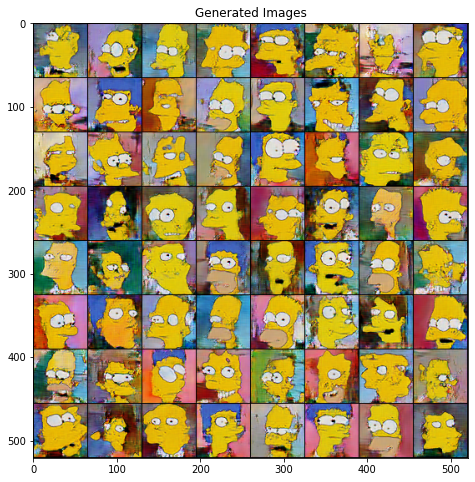

Epoch [1221/2000], Step [32/32], Gen. Loss: 6.7747, Disc Loss: 0.0211
Epoch [1222/2000], Step [32/32], Gen. Loss: 6.7399, Disc Loss: 0.0934
Epoch [1223/2000], Step [32/32], Gen. Loss: 5.8286, Disc Loss: 0.0392
Epoch [1224/2000], Step [32/32], Gen. Loss: 6.2489, Disc Loss: 0.0186
Epoch [1225/2000], Step [32/32], Gen. Loss: 6.1697, Disc Loss: 0.0140
Epoch [1226/2000], Step [32/32], Gen. Loss: 6.5659, Disc Loss: 0.0107
Epoch [1227/2000], Step [32/32], Gen. Loss: 6.4877, Disc Loss: 0.0089
Epoch [1228/2000], Step [32/32], Gen. Loss: 6.3468, Disc Loss: 0.0100
Epoch [1229/2000], Step [32/32], Gen. Loss: 6.6149, Disc Loss: 0.0085
Epoch [1230/2000], Step [32/32], Gen. Loss: 6.4960, Disc Loss: 0.0083
Epoch [1231/2000], Step [32/32], Gen. Loss: 6.4012, Disc Loss: 0.0109
Epoch [1232/2000], Step [32/32], Gen. Loss: 6.5611, Disc Loss: 0.0088
Epoch [1233/2000], Step [32/32], Gen. Loss: 6.6882, Disc Loss: 0.0077
Epoch [1234/2000], Step [32/32], Gen. Loss: 6.5781, Disc Loss: 0.0084
Epoch [1235/2000], S

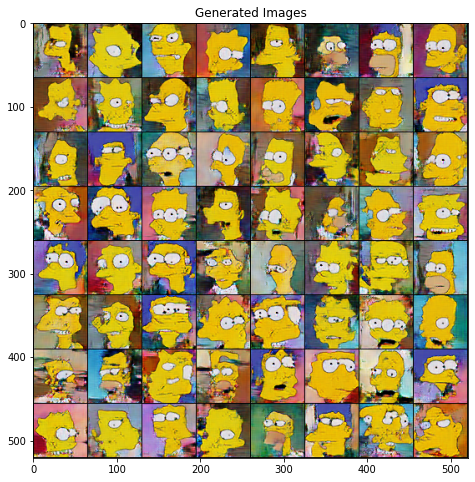

Epoch [1241/2000], Step [32/32], Gen. Loss: 6.3844, Disc Loss: 0.0096
Epoch [1242/2000], Step [32/32], Gen. Loss: 6.4489, Disc Loss: 0.0099
Epoch [1243/2000], Step [32/32], Gen. Loss: 6.5165, Disc Loss: 0.0065
Epoch [1244/2000], Step [32/32], Gen. Loss: 6.4185, Disc Loss: 0.0079
Epoch [1245/2000], Step [32/32], Gen. Loss: 6.4118, Disc Loss: 0.0092
Epoch [1246/2000], Step [32/32], Gen. Loss: 6.0588, Disc Loss: 0.0154
Epoch [1247/2000], Step [32/32], Gen. Loss: 6.4561, Disc Loss: 0.0090
Epoch [1248/2000], Step [32/32], Gen. Loss: 6.4545, Disc Loss: 0.0110
Epoch [1249/2000], Step [32/32], Gen. Loss: 6.4567, Disc Loss: 0.0105
Epoch [1250/2000], Step [32/32], Gen. Loss: 6.5084, Disc Loss: 0.0101
Epoch [1251/2000], Step [32/32], Gen. Loss: 6.4644, Disc Loss: 0.0093
Epoch [1252/2000], Step [32/32], Gen. Loss: 6.6272, Disc Loss: 0.0086
Epoch [1253/2000], Step [32/32], Gen. Loss: 6.6794, Disc Loss: 0.0075
Epoch [1254/2000], Step [32/32], Gen. Loss: 6.4908, Disc Loss: 0.0081
Epoch [1255/2000], S

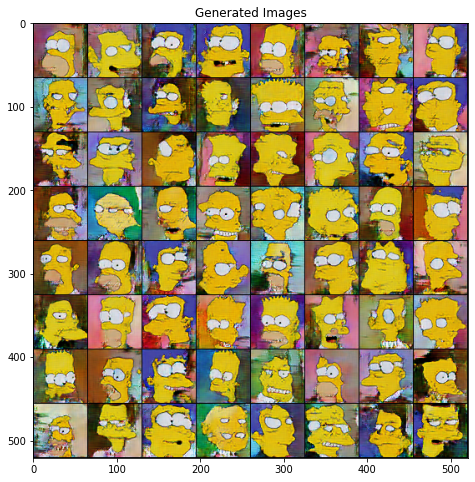

Epoch [1261/2000], Step [32/32], Gen. Loss: 6.3286, Disc Loss: 0.0098
Epoch [1262/2000], Step [32/32], Gen. Loss: 6.6257, Disc Loss: 0.0073
Epoch [1263/2000], Step [32/32], Gen. Loss: 6.6853, Disc Loss: 0.0086
Epoch [1264/2000], Step [32/32], Gen. Loss: 6.7824, Disc Loss: 0.0067
Epoch [1265/2000], Step [32/32], Gen. Loss: 6.5994, Disc Loss: 0.0074
Epoch [1266/2000], Step [32/32], Gen. Loss: 6.3755, Disc Loss: 0.0106
Epoch [1267/2000], Step [32/32], Gen. Loss: 6.7620, Disc Loss: 0.0078
Epoch [1268/2000], Step [32/32], Gen. Loss: 6.4936, Disc Loss: 0.0069
Epoch [1269/2000], Step [32/32], Gen. Loss: 6.5910, Disc Loss: 0.0073
Epoch [1270/2000], Step [32/32], Gen. Loss: 6.3771, Disc Loss: 0.0090
Epoch [1271/2000], Step [32/32], Gen. Loss: 6.2345, Disc Loss: 0.0149
Epoch [1272/2000], Step [32/32], Gen. Loss: 6.6010, Disc Loss: 0.0097
Epoch [1273/2000], Step [32/32], Gen. Loss: 6.8770, Disc Loss: 0.0090
Epoch [1274/2000], Step [32/32], Gen. Loss: 6.6555, Disc Loss: 0.0078
Epoch [1275/2000], S

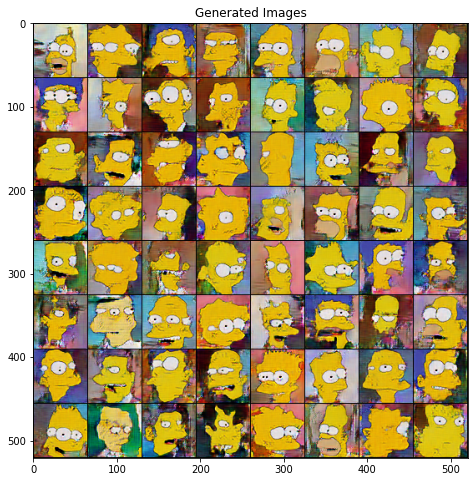

Epoch [1281/2000], Step [32/32], Gen. Loss: 6.3833, Disc Loss: 0.0121
Epoch [1282/2000], Step [32/32], Gen. Loss: 6.6125, Disc Loss: 0.0073
Epoch [1283/2000], Step [32/32], Gen. Loss: 6.6283, Disc Loss: 0.0076
Epoch [1284/2000], Step [32/32], Gen. Loss: 6.7246, Disc Loss: 0.0069
Epoch [1285/2000], Step [32/32], Gen. Loss: 6.5138, Disc Loss: 0.0072
Epoch [1286/2000], Step [32/32], Gen. Loss: 6.5307, Disc Loss: 0.0063
Epoch [1287/2000], Step [32/32], Gen. Loss: 6.9293, Disc Loss: 0.0064
Epoch [1288/2000], Step [32/32], Gen. Loss: 6.7807, Disc Loss: 0.0066
Epoch [1289/2000], Step [32/32], Gen. Loss: 6.8793, Disc Loss: 0.0069
Epoch [1290/2000], Step [32/32], Gen. Loss: 6.7887, Disc Loss: 0.0077
Epoch [1291/2000], Step [32/32], Gen. Loss: 6.4477, Disc Loss: 0.0089
Epoch [1292/2000], Step [32/32], Gen. Loss: 6.7591, Disc Loss: 0.0064
Epoch [1293/2000], Step [32/32], Gen. Loss: 6.6887, Disc Loss: 0.0072
Epoch [1294/2000], Step [32/32], Gen. Loss: 6.4425, Disc Loss: 0.0090
Epoch [1295/2000], S

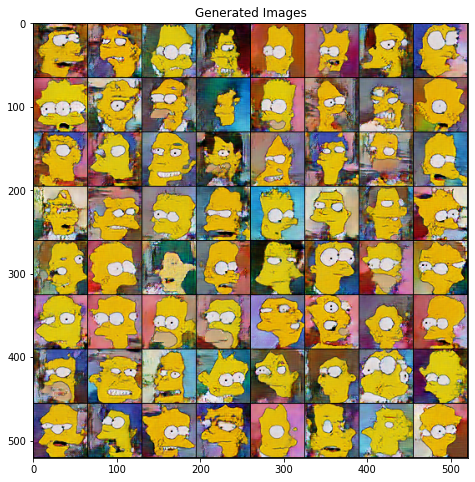

Epoch [1301/2000], Step [32/32], Gen. Loss: 6.7875, Disc Loss: 0.0062
Epoch [1302/2000], Step [32/32], Gen. Loss: 6.7783, Disc Loss: 0.0074
Epoch [1303/2000], Step [32/32], Gen. Loss: 6.8201, Disc Loss: 0.0063
Epoch [1304/2000], Step [32/32], Gen. Loss: 6.5044, Disc Loss: 0.0103
Epoch [1305/2000], Step [32/32], Gen. Loss: 6.8915, Disc Loss: 0.0098
Epoch [1306/2000], Step [32/32], Gen. Loss: 6.5173, Disc Loss: 0.0094
Epoch [1307/2000], Step [32/32], Gen. Loss: 6.7909, Disc Loss: 0.0063
Epoch [1308/2000], Step [32/32], Gen. Loss: 6.8008, Disc Loss: 0.0073
Epoch [1309/2000], Step [32/32], Gen. Loss: 6.4218, Disc Loss: 0.0140
Epoch [1310/2000], Step [32/32], Gen. Loss: 6.7633, Disc Loss: 0.0081
Epoch [1311/2000], Step [32/32], Gen. Loss: 6.9337, Disc Loss: 0.0065
Epoch [1312/2000], Step [32/32], Gen. Loss: 6.7888, Disc Loss: 0.0075
Epoch [1313/2000], Step [32/32], Gen. Loss: 6.4749, Disc Loss: 0.0355
Epoch [1314/2000], Step [32/32], Gen. Loss: 5.5984, Disc Loss: 0.1989
Epoch [1315/2000], S

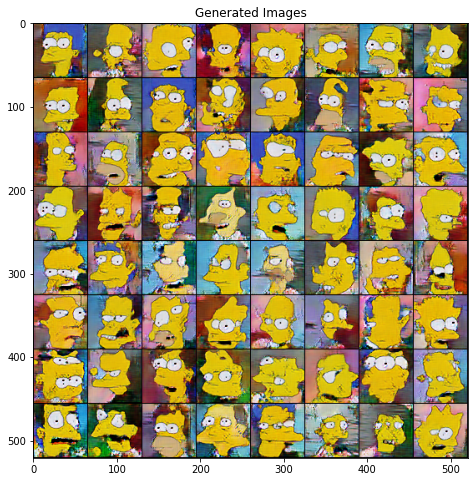

Epoch [1321/2000], Step [32/32], Gen. Loss: 6.2792, Disc Loss: 0.0164
Epoch [1322/2000], Step [32/32], Gen. Loss: 6.3938, Disc Loss: 0.0106
Epoch [1323/2000], Step [32/32], Gen. Loss: 6.3923, Disc Loss: 0.0133
Epoch [1324/2000], Step [32/32], Gen. Loss: 5.7104, Disc Loss: 0.0345
Epoch [1325/2000], Step [32/32], Gen. Loss: 6.4873, Disc Loss: 0.0132
Epoch [1326/2000], Step [32/32], Gen. Loss: 6.5753, Disc Loss: 0.0085
Epoch [1327/2000], Step [32/32], Gen. Loss: 6.7295, Disc Loss: 0.0084
Epoch [1328/2000], Step [32/32], Gen. Loss: 6.4290, Disc Loss: 0.0095
Epoch [1329/2000], Step [32/32], Gen. Loss: 6.4972, Disc Loss: 0.0082
Epoch [1330/2000], Step [32/32], Gen. Loss: 6.5178, Disc Loss: 0.0145
Epoch [1331/2000], Step [32/32], Gen. Loss: 5.9080, Disc Loss: 0.0569
Epoch [1332/2000], Step [32/32], Gen. Loss: 5.7225, Disc Loss: 0.0317
Epoch [1333/2000], Step [32/32], Gen. Loss: 6.2126, Disc Loss: 0.0156
Epoch [1334/2000], Step [32/32], Gen. Loss: 6.4676, Disc Loss: 0.0124
Epoch [1335/2000], S

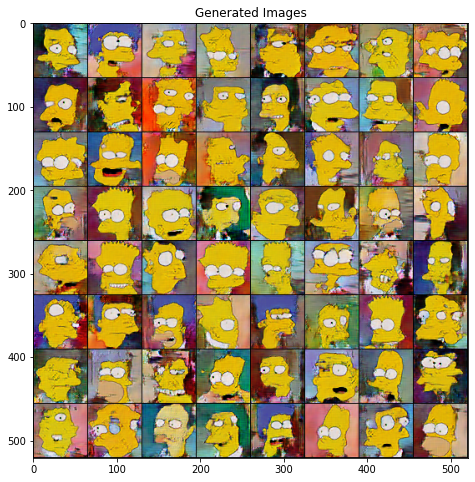

Epoch [1341/2000], Step [32/32], Gen. Loss: 6.7615, Disc Loss: 0.0093
Epoch [1342/2000], Step [32/32], Gen. Loss: 6.4096, Disc Loss: 0.0091
Epoch [1343/2000], Step [32/32], Gen. Loss: 6.5884, Disc Loss: 0.0086
Epoch [1344/2000], Step [32/32], Gen. Loss: 6.6581, Disc Loss: 0.0072
Epoch [1345/2000], Step [32/32], Gen. Loss: 6.6799, Disc Loss: 0.0078
Epoch [1346/2000], Step [32/32], Gen. Loss: 6.5438, Disc Loss: 0.0085
Epoch [1347/2000], Step [32/32], Gen. Loss: 6.4879, Disc Loss: 0.0092
Epoch [1348/2000], Step [32/32], Gen. Loss: 6.6987, Disc Loss: 0.0072
Epoch [1349/2000], Step [32/32], Gen. Loss: 6.6919, Disc Loss: 0.0077
Epoch [1350/2000], Step [32/32], Gen. Loss: 6.6791, Disc Loss: 0.0070
Epoch [1351/2000], Step [32/32], Gen. Loss: 6.7875, Disc Loss: 0.0063
Epoch [1352/2000], Step [32/32], Gen. Loss: 6.7173, Disc Loss: 0.0065
Epoch [1353/2000], Step [32/32], Gen. Loss: 6.6675, Disc Loss: 0.0075
Epoch [1354/2000], Step [32/32], Gen. Loss: 6.6512, Disc Loss: 0.0074
Epoch [1355/2000], S

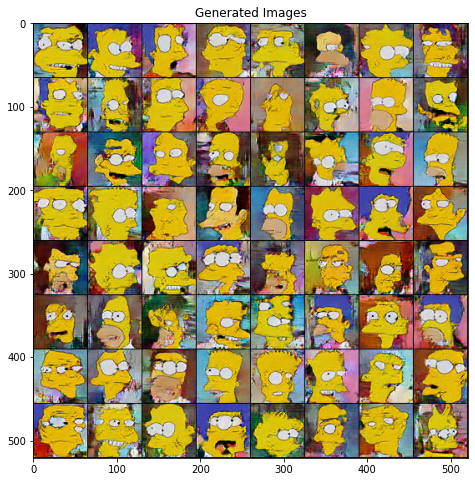

Epoch [1361/2000], Step [32/32], Gen. Loss: 6.7252, Disc Loss: 0.0065
Epoch [1362/2000], Step [32/32], Gen. Loss: 6.7062, Disc Loss: 0.0067
Epoch [1363/2000], Step [32/32], Gen. Loss: 6.7487, Disc Loss: 0.0093


In [ ]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
import imageio
import numpy as np

# Define Geneartor and Discriminator networks
gan_gen = Generator(64)
gan_disc = Discriminator()

#Initialize indepdent optimizer for both networks
learning_rate_gen = .0014
learning_rate_disc = .00005
optimizer_gen = torch.optim.Adam(gan_gen.parameters(),lr = learning_rate_gen, weight_decay=1e-5)
optimizer_disc = torch.optim.Adam(gan_disc.parameters(),lr = learning_rate_disc, weight_decay=1e-7)

# Train the GAN
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
losses_list_disc, losses_list_gen = train_GAN(gan_gen,gan_disc, train_loader, optimizer_gen, optimizer_disc,
                      num_epochs=2000, model_name='simpson_2000.ckpt', device=device)

Text(0.5, 1.0, 'LOSS ')

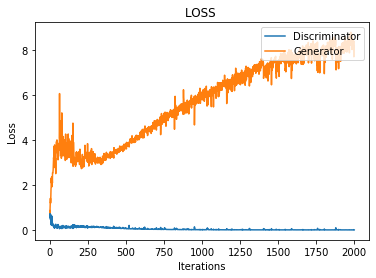

In [7]:
# Loss function iterations
import matplotlib.pyplot as plt
plt.plot(losses_list_disc, label='Discriminator')
plt.plot(losses_list_gen, label='Generator')
plt.legend(loc = 'upper right')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.title('LOSS ')

In [8]:
import imageio
import numpy as np
from IPython.display import Image

### Generate random samples
gan_gen = Generator(64)
gan_gen.load_state_dict(torch.load(results_path+'/simpson_1000.ckpt'))
gan_gen = gan_gen.to(device)
gan_gen.eval()


n_samples = 64
n_iterpolations =50
z_init = torch.randn((n_samples,64)).to(device)
z_final = torch.randn((n_samples,64)).to(device)

interpolation_images = []
for interp in range(0,n_iterpolations):
  interp_0_1 = float(interp) / (n_iterpolations-1)
  z = z_init*interp_0_1 + z_final*(1-interp_0_1)
  x_rec = gan_gen.decoder(z.to(device))
  image_grid = make_grid(x_rec.cpu(),nrow=8,padding=1)
  image_grid = image_grid.permute(1,2,0).detach().numpy()

  interpolation_images.append((image_grid*255.0).astype(np.uint8))
interpolation_images += interpolation_images[::-1]

imname = results_path+'/simpson_interpolation_1000_2.gif'
imageio.mimsave(imname, interpolation_images, fps=25)

In [9]:
# Load generator
gan_gen = Generator(64)
gan_gen.load_state_dict(torch.load(results_path+'/simpson_2000.ckpt'))
gan_gen.eval() # Put in eval model
gan_gen = gan_gen.to(device)

# Generate random images from sampled vectors z and visualize them 
x_gen = gan_gen.sample(64,device=device)
image_grid = make_grid(x_gen.cpu(),nrow=5,padding=1)
plt.figure(figsize=(40,40))
plt.imshow(image_grid.permute(1,2,0).detach().numpy())

Output hidden; open in https://colab.research.google.com to view.